# Load modules

In [ ]:
# autoreload
%load_ext autoreload
%autoreload 2

## imports
# general
import json
import pathlib
from copy import deepcopy
import itertools
from itertools import chain
import math
from functools import reduce
import pickle

# data science
import numpy as np
import pandas as pd
# from scipy.stats import pearsonr
import scipy.cluster.hierarchy as sch
# from sklearn.linear_model import LinearRegression
import scikit_posthocs as sp # post-hoc tests for statistical analysis
from scipy.stats import pearsonr, spearmanr
import matplotlib as mpl  # main package for plotting
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import seaborn as sns
from sklearn.decomposition import PCA
from sklearn.metrics.pairwise import cosine_similarity

# single cell
import anndata as ad  # main package for single cell data
import scanpy as sc  # main package for single cell analysis
import muon as mu  # package for multi-omic single cell data
import celltypist  # package for cell type annotation
import scirpy as ir # package for single cell receptor analysis
import scvi
import bbknn

# helpers
import os
import sys
sys.path.append('/home/divy/projects/jones-salim_tuning/thresholdpy')
import raval_preprocessing as rpp
import thresholdpy as tp
from jones_helper_functions import *

## settings
# set paths
PATH_PROJ_DIR = pathlib.Path(".")  # project directory
PATH_DATA_DIR = pathlib.Path(PATH_PROJ_DIR) / "data"
PATH_FIG_DIR = pathlib.Path(PATH_PROJ_DIR) / "figures" / "analysis"
PATH_EXPORT_DIR = pathlib.Path(PATH_PROJ_DIR) / "export" / "analysis"  # export directory
# create figures directory if it does not exist
PATH_FIG_DIR.mkdir(parents=True, exist_ok=True)
PATH_EXPORT_DIR.mkdir(parents=True, exist_ok=True)

FIG_TYPE = "svg"
DPI_SCALE = 300  # dpi scale for figures
FONT_SIZE = 10  # set font size for figures
sc.settings._file_format_figs = FIG_TYPE
# set scanpy settings
sc.settings.figdir = PATH_FIG_DIR  # set figure directory
# svg format, dpi, transparent background
sc.settings.set_figure_params(format=FIG_TYPE, dpi=DPI_SCALE, transparent=True, fontsize=FONT_SIZE)

# export matplotlib as svgs
# Set the global default figure size
plt.rcParams["figure.figsize"] = (3, 3)
plt.rcParams["pdf.fonttype"] = 42  # set font type for pdfs
plt.rcParams["ps.fonttype"] = 42  # set font type for postscript files
# plt.rcParams['figure.dpi'] = 600
# plt.rcParams['savefig.dpi'] = 600
# disable grid
mpl.rcParams["axes.grid"] = False  # disable grid in plots
plt.rcParams.update({"font.size": FONT_SIZE})  # set font size for matplotlib


# set random seed for reproducibility
SEED = 82
np.random.seed(SEED)  # set random seed for numpy

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [ ]:
random_number = np.random.rand()
print(random_number)

0.27522566980133767


## Reloads

In [ ]:
import importlib

# importlib.reload(tp)
importlib.reload(sc)
# from scanpy.tools import _score_genes as sc_score_genes

# importlib.reload(sc_score_genes)

## Define fixed protein names

In [ ]:
namefix = {
    "Hu.CD2": "CD2",
    "Hu.CD3_UCHT1": "CD3",
    "Hu.CD4_RPA.T4": "CD4",
    "Hu.CD5": "CD5",
    "Hu.CD7": "CD7",
    "Hu.CD8": "CD8a",
    "Hu.CD11b": "CD11b (ITGAM)",
    "Hu.CD11c": "CD11c (ITGAX)",
    "Hu.CD16": "CD16 (FcGR3)",
    "Hu.CD19": "CD19",
    "Hu.CD20_2H7": "CD20",
    "Hu.CD21": "CD21",
    "Hu.CD25": "CD25",
    "Hu.CD27": "CD27",
    "Hu.CD28": "CD28",
    "Hu.CD32": "CD32 (FCGR2A)",
    "Hu.CD33": "CD33 (SIGLEC3)",
    "Hu.CD39": "CD39 (ENTPD1)",
    "Hu.CD41": "CD41 (ITGA2B)",
    "Hu.CD42b": "CD42b (GP1BB)",
    "HuMs.CD44": "CD44",
    "Hu.CD45_HI30": "CD45",
    "Hu.CD45RO": "CD45RO",
    "Hu.CD45RA": "CD45RA",
    "Hu.CD49a": "CD49a (ITGA1)",
    "Hu.CD49b": "CD49b (ITGA2)",
    "HuMs.CD49f": "CD49f (ITGA6)",
    "Hu.CD52": "CD52",
    "Hu.CD54": "CD54 (ICAM1)",
    "Hu.CD56": "CD56 (NCAM1)",
    "Hu.CD58": "CD58 (LFA3)",
    "Hu.CD62L": "CD62L (SELL)",
    "Hu.CD62P": "CD62P (SELP)",
    "Hu.CD69": "CD69",
    "Hu.CD71": "CD71 (TfR1)",
    "Hu.CD82": "CD82",
    "Hu.CD80": "CD80 (B7-1)",
    "Hu.CD83": "CD83",
    "Hu.CD86": "CD86 (B7-2)",
    "Hu.CD94": "CD94 (KLRD1)",
    "Hu.CD95": "CD95 (FAS)",
    "Hu.CD101": "CD101 (IGSF2)",
    "Hu.CD107a": "CD107a (LAMP1)",
    "Hu.CD112": "CD112 (Nectin2)",
    "Hu.CD123": "CD123 (IL3Ra)",
    "Hu.CD127": "CD127 (IL-7Ra)",
    "Hu.CD134": "CD134 (OX40)",
    "Hu.CD137": "CD137 (4-1BB)",
    "Hu.CD152": "CD152 (CTLA4)",
    "Hu.CD154": "CD154 (CD40L)",
    "Hu.CD158": "CD158 (KIR2DL1)",
    "Hu.CD158b": "CD158b (KIR2DL2)",
    "Hu.CD158e1": "CD158e1 (KIR3DL1)",
    "Hu.CD161": "CD161 (KLRB1)",
    "Hu.CD163": "CD163 (M130)",
    "Hu.CD185": "CD185 (CXCR5)",
    "Hu.CD194": "CD194 (CCR4)",
    "Hu.CD195": "CD195 (CCR5)",
    "Hu.CD196": "CD196 (CCR6)",
    "Hu.CD197": "CD197 (CCR7)",
    "Hu.CD223": "CD223 (LAG3)",
    "Hu.CD226_11A8": "CD226 (DNAM1)",
    "Hu.CD244": "CD244 (2B4)",
    "HuMsRt.CD278": "CD278 (ICOS)",
    "Hu.CD279": "CD279 (PD1)",
    "Hu.CD314": "CD314 (NKG2D)",
    "Hu.CD335": "CD335 (NKp46)",
    "Hu.CD336": "CD336 (NKp44)",  # Not in set
    "Hu.CD352": "CD352 (SLAMF6)",
    "Hu.CD366": "CD366 (LAG3, HAVCR2)",  # Not in set
    "Hu.CLEC12A": "CLEC12A",
    "Hu.CX3CR1": "CX3CR1",
    "Hu.HLA.ABC": "HLA-ABC",
    "Hu.HLA.E": "HLA-E",
    "HuMs.integrin.b7": "ITGB7",
    "Hu.KLRG1": "KLRG1",
    "Hu.TCR.AB": "TCRab",
    "Hu.TCR.Va7.2": "TCRVa7.2 (MAIT)",
    "Hu.TCR.Vd2": "TCRVd2",
    "Hu.TIGIT": "TIGIT",
    "Isotype_RTK2758": "Isotype RTK2758",
    "Isotype_MOPC.21": "Isotype MOPC.21",
}

# Annotation

In [ ]:
mdata_qc = mu.read_h5mu(
    PATH_DATA_DIR / "processed" / "mdata_qc.h5mu",
)  # read the MuData object back
mdata_qc

MuData object with n_obs × n_vars = 5684 × 36738
  var:	'gene_ids', 'feature_types', 'genome', 'pattern', 'read', 'sequence'
  2 modalities
    rna:	5684 x 36601
      obs:	'n_genes_by_counts', 'total_counts', 'pct_counts_in_top_20_genes', 'total_counts_mito', 'pct_counts_mito', 'total_counts_ribo', 'pct_counts_ribo', 'outliers_empty', 'outliers_multiplets', 'outliers_mito', 'outliers_ribo', 'S_score', 'G2M_score', 'phase', 'leiden_res1', 'celltypist_leiden_res1', 'celltypist_leiden_res1_conf', 'union_cd4_score', 'union_cd8_score', 'naive-cm-like_score', 'cd45ro+effector-memory_score', 'interferon-signaling_score', 'memory/proliferation_score', 'nk-like/cd45ra+effector-memory_score', 'exhaustion_score', 'cell_type', 'leidenP_res0.7', 'CD4+CTL_score', 'CD4+PD1_score', 'CD4+T_score', 'CD4+Tmem_score', 'CD8+T_score', 'CD8+Tmem_score', 'gdT_score', 'CD8aa(I)_score', 'CD8aa(II)_score', 'NK_score', 'ILC3_score', 'NKT_score', 'T(agonist)_score', 'Tfh_score', 'Th17_score', 'Treg_score', 'Treg(diff)_score', 'cell_type_biorxiv', 'cell_type_ross1', 'cell_type_ross2', 'hs-ImCD4_score', 'hs-MatCD4_score', 'hs-ImCD8_score', 'hs-MatCD8_score', 'hs-CD8_score', 'Naive-/CM-like_score', 'Tem_score', 'TTCRC4_score', 'ISG_score', 'Tmem/prolif_score', 'NKL/Temra_score', 'Exhaustion_score', 'union_cd4_sc_log1p_score', 'union_cd8_sc_log1p_score', 'cd4_sc_log1p_score', 'cd8_sc_log1p_score', 'Naive-/CM-like_sc_log1p_score', 'Tem_sc_log1p_score', 'ISG_sc_log1p_score', 'Tmem/prolif_sc_log1p_score', 'NKL/Temra_sc_log1p_score', 'Exhaustion_sc_log1p_score', 'hs-ImCD4_sc_log1p_score', 'hs-MatCD4_sc_log1p_score', 'hs-ImCD8_sc_log1p_score', 'hs-MatCD8_sc_log1p_score', 'hs-CD8_sc_log1p_score', 'CD4+CTL_sc_log1p_score', 'CD4+PD1_sc_log1p_score', 'CD4+T_sc_log1p_score', 'CD4+Tmem_sc_log1p_score', 'CD8+T_sc_log1p_score', 'CD8+Tmem_sc_log1p_score', 'gdT_sc_log1p_score', 'CD8aa(I)_sc_log1p_score', 'CD8aa(II)_sc_log1p_score', 'NK_sc_log1p_score', 'ILC3_sc_log1p_score', 'NKT_sc_log1p_score', 'T(agonist)_sc_log1p_score', 'Tfh_sc_log1p_score', 'Th17_sc_log1p_score', 'Treg_sc_log1p_score', 'Treg(diff)_sc_log1p_score', 'union_cd4_sc_log1p_zscore_score', 'union_cd8_sc_log1p_zscore_score', 'cd4_sc_log1p_zscore_score', 'cd8_sc_log1p_zscore_score', 'Naive-/CM-like_sc_log1p_zscore_score', 'Tem_sc_log1p_zscore_score', 'ISG_sc_log1p_zscore_score', 'Tmem/prolif_sc_log1p_zscore_score', 'NKL/Temra_sc_log1p_zscore_score', 'Exhaustion_sc_log1p_zscore_score', 'hs-ImCD4_sc_log1p_zscore_score', 'hs-MatCD4_sc_log1p_zscore_score', 'hs-ImCD8_sc_log1p_zscore_score', 'hs-MatCD8_sc_log1p_zscore_score', 'hs-CD8_sc_log1p_zscore_score', 'CD4+CTL_sc_log1p_zscore_score', 'CD4+PD1_sc_log1p_zscore_score', 'CD4+T_sc_log1p_zscore_score', 'CD4+Tmem_sc_log1p_zscore_score', 'CD8+T_sc_log1p_zscore_score', 'CD8+Tmem_sc_log1p_zscore_score', 'gdT_sc_log1p_zscore_score', 'CD8aa(I)_sc_log1p_zscore_score', 'CD8aa(II)_sc_log1p_zscore_score', 'NK_sc_log1p_zscore_score', 'ILC3_sc_log1p_zscore_score', 'NKT_sc_log1p_zscore_score', 'T(agonist)_sc_log1p_zscore_score', 'Tfh_sc_log1p_zscore_score', 'Th17_sc_log1p_zscore_score', 'Treg_sc_log1p_zscore_score', 'Treg(diff)_sc_log1p_zscore_score', 'union_cd4_sc_ccreg_score', 'union_cd8_sc_ccreg_score', 'cd4_sc_ccreg_score', 'cd8_sc_ccreg_score', 'Naive-/CM-like_sc_ccreg_score', 'Tem_sc_ccreg_score', 'ISG_sc_ccreg_score', 'Tmem/prolif_sc_ccreg_score', 'NKL/Temra_sc_ccreg_score', 'Exhaustion_sc_ccreg_score', 'hs-ImCD4_sc_ccreg_score', 'hs-MatCD4_sc_ccreg_score', 'hs-ImCD8_sc_ccreg_score', 'hs-MatCD8_sc_ccreg_score', 'hs-CD8_sc_ccreg_score', 'CD4+CTL_sc_ccreg_score', 'CD4+PD1_sc_ccreg_score', 'CD4+T_sc_ccreg_score', 'CD4+Tmem_sc_ccreg_score', 'CD8+T_sc_ccreg_score', 'CD8+Tmem_sc_ccreg_score', 'gdT_sc_ccreg_score', 'CD8aa(I)_sc_ccreg_score', 'CD8aa(II)_sc_ccreg_score', 'NK_sc_ccreg_score', 'ILC3_sc_ccreg_score', 'NKT_sc_ccreg_score', 'T(agonist)_sc_ccreg_score', 'Tfh_sc_ccreg_score', 'Th17_sc_ccreg_score', 'Treg_sc_ccreg_score', 'Treg(diff)_sc_ccreg_score', 'union_cd4_sc-all_log

## Gene/Protein Dotplots

### Transfer dendrograms annotations

In [ ]:
## transfer dendrogram to rna

for res in [1, 1.1]:
    # dendrogram for leiden clustering
    sc.tl.dendrogram(
        mdata_qc["rna"],  # type: ignore
        groupby=f"leiden_res{res}",
    )

    # Cluster rows (clusters)
    row_order = np.flip(
        np.array(
            mdata_qc["rna"].uns[f"dendrogram_leiden_res{res}"]["categories_ordered"]
        ).astype(int)
    )  # reverse order for plotting

    # transfer celltype
    mdata_qc["rna"].uns[f"dendrogram_leiden_res{res}"]["categories_ordered"] = np.array(
        row_order
    ).astype(str)

    ## transfer dendrogram to protein
    mdata_qc["prot"].obs[f"leiden_res{res}"] = mdata_qc["rna"].obs[
        f"leiden_res{res}"
    ]  # copy leiden clustering from RNA to ADT
    
    # copy dendrogram from RNA to ADT
    mdata_qc["prot"].uns[f"dendrogram_leiden_res{res}"] = mdata_qc["rna"].uns[
        f"dendrogram_leiden_res{res}"
    ]

### Define RNA/protein lists

Useful gene set refs:
* CD8 M<=>E progression: Escobar et al (2020) Science Immunology
    * See https://pmc.ncbi.nlm.nih.gov/articles/PMC8221367/figure/F3/
* CD4 M<=> progression: Cano-Gamez et al (2020) Nature Comm
    * See https://www.nature.com/articles/s41467-020-15543-y/figures/3
    * Kinda a weird one - don't like their "effectorness" scoring which is just pseudotime [0, 1] scaling
* CD4 thymic dev: Chopp et al (2020) Immunity
* Thymic atlas:   Park  et al (2020) Science
* ILC genes:
    * Li et al (2019) JACI (https://www.jacionline.org/article/S0091-6749(19)30277-5/fulltext)
    

In [ ]:
mdata_qc["rna"].var_names[mdata_qc["rna"].var_names.str.contains("KIR")]

Index(['AKIRIN1', 'KIRREL1', 'KIRREL1-IT1', 'NKIRAS1', 'AKIRIN2', 'KIRREL3',
       'KIRREL3-AS1', 'KIRREL3-AS2', 'KIRREL3-AS3', 'NKIRAS2', 'KIRREL2',
       'KIR3DL3', 'KIR2DL3', 'KIR2DL1', 'KIR2DL4', 'KIR3DL1', 'KIR3DL2'],
      dtype='object')

In [ ]:
mdata_qc["prot"].var_names[mdata_qc["prot"].var_names.str.contains("152")]

Index(['Hu.CD152'], dtype='object')

In [ ]:
rna_names = {
    "TCR": ["CD3E", "CD3D", "PTCRA", "TRAC", "TRBC1", "TRBC2", "TRGC1", "TRDC"],
    "4SP": ["CD4", "ZBTB7B", "CD40LG", "GATA3", "CCR4", "CCR6", "CXCR5"],
    "8SP": ["CD8A", "CD8B", "RUNX3", "GZMB", "GZMA", "PRF1", "GNLY"],
    "Stim": [
        "CD69",
        "IL2RA",  # CD25
        "CD38",  # ADPRC1
        "CD5",
        "CD7",  # Downreg after TCR stim
        "TFRC",  # CD71
        "LAMP1",
    ],  # CD107A (marks degranulation)
    "Naive/CM": [
        "KLF2",
        "CD27",
        "CD28",
        "CCR7",
        "TCF7",  # Tcf1 protein
        "SELL",  # CD62L
        "IL7R",  # CD127
        "LEF1",
        "S1PR1",
    ],
    "EM/Eff": [
        "CD44",
        "KLRG1",
        "KLRB1",  # CD161
        "NKG7",
        "TBX21",  # T-bet
        "SLAMF6",
        "CXCR3",
        "CX3CR1",
    ],
    "Exhaustion": [
        "PDCD1",  # PD1
        "CTLA4",
        "LAG3",
        "HAVCR2",  # TIM3
        "ENTPD1",  # CD39
        "TIGIT",
        "TOX",
        "BATF",
        "EOMES",
    ],
    "Apoptosis": ["BCL2", "BCL2L1", "BAX", "CASP3", "FASLG"],
    "Proliferation": ["MKI67", "TOP2A", "PCNA", "CCNB1", "CDK1"],
    "Cytokines": [
        "IFNG",
        "IL2",
        "IL4",
        "IL9",
        "IL10",
        "IL17A",
        "TGFB1",
    ],
    # "Chemokine Recs": ["CCR3", "CCR4", "CCR5", "CCR6", "CXCR3", "CXCR4", "CXCR5", "CXCR6"],
    "Other DEGs": ["LIME1", "GLIPR2", "ID2", "CSF1", "GBP5", "P2RX5", "PDCD4"],
    # "Innate": ["CD33", "CD14","CLEC7A"]
    "NK": [
        "NCAM1",  # CD56
        "FCGR3A",  # CD16a
        # "FCGR3B", # CD16b
        "NCR1",  # NKp46
        "NCR2",  # NKp44
        "NCR3",  # NKp30
        # "KIR2DL1",
        # "KIR3DL1",
        "KLRF1",
        "KLRC1",
        "KLRC2",
        "KLRD1",  # NKp80, NKG2A, NKG2C
    ],
    "Treg": [
        "FOXP3",
        "IL2RA",
        "CTLA4",
        "IKZF2",  # Helios
        "IKZF4",  # Eos
        "IL10",
        "IL12A",  # IL12A + EBI3 = IL35
        "EBI3",
        "TGFB1",
        "TNFRSF4",
        "TNFRSF18",
    ],
    # "Th17": ["RORC", "IL17A", "IL17F", "IL23R", "STAT3", "IRF4", "BATF"],
    "ILC all": [
        "IL7R",
        "KLRB1",  # CD161
        "ID2",
        "RUNX3",
        "ZBTB16",  # PLZF
        "KLRG1",
        "LEF1",
    ],
    "ILC1": [
        "TBX21",  # T-bet
        "CD200R1",
        "EOMES",  # Should be negative!
        "IFNG",
        "TNF",
        "CCL5",
        "CXCR3",  # CD183
        "CXCR4",  # CD184
        "IL12RB1",
        "IL18R1",
    ],
    "ILC2": [
        "GATA3",
        "RORA",
        "KIT",  # CD117
        "PTGDR2",  # CRTH2
        "IL4",
        "IL5",
        "IL13",
        "IL1RL1",  # ST2 (IL-33 receptor)
        "AREG",
    ],
    "ILC3": [
        "RORC",
        "AHR",
        "KIT",  # CD117
        "CCR6",
        "IL17A",
        "IL17F",
        "IL22",
        "IL1R1",
    ],
}


prot_names = {
    "TCR": ["Hu.TCR.AB", "Hu.TCR.Va7.2", "Hu.TCR.Vd2", "Hu.CD3_UCHT1", "Hu.CD69"],
    "SP": ["Hu.CD4_RPA.T4", "Hu.CD8", "Hu.CD45RO", "Hu.CD45RA"],
    # "Alt-Lineages": ["Hu.CD152"],
    "Activated": ["Hu.CD5", "Hu.CD7", "Hu.CD25", "Hu.CD71", "Hu.CD107a"],
    "Innate": ["Hu.CD56", "Hu.CD16", "Hu.CD161"],
}

prot_names_fixed = [namefix[x] for x in np.concatenate(list(prot_names.values()))]


prot_names2 = {
    "TCR": [
        "Hu.CD3_UCHT1",
        "Hu.TCR.AB",
        "Hu.TCR.Va7.2",
        "Hu.TCR.Vd2",
    ],  # Va7.2: comming in MAIT
    "SP": ["Hu.CD4_RPA.T4", "Hu.CD8"],
    "Memory": [
        "Hu.CD45RA",
        "Hu.CD45RO",
        "Hu.CD27",
        "Hu.CD28",
        "Hu.CD62L",  # SELL
        "Hu.CD127",  # IL-7Ra
        "Hu.CD95",  # FAS (in non-naive cells)
        "HuMs.CD44",  # hyaluronic acid receptor, EM marker
    ],
    "Effector": ["Hu.CD185", "Hu.CD352", "Hu.CX3CR1"],  # CXCR5  # SLAMF6
    "Costim": [
        "Hu.CD134",  # OX40
        "Hu.CD137",  # 4-1BB
        "Hu.CD154",  # CD40L
        "HuMsRt.CD278",  # ICOS
    ],
    # "Receptors": ["Hu.CD127", "Hu.CD123", "Hu.CD124"],  # IL-7Ra, 4Ra, 3Ra
    "Activation": [
        "Hu.CD69",
        "Hu.CD25",
        "Hu.CD5",  # standard upreg after stim
        "Hu.CD7",  # downreg after TCR stim
        "Hu.CD71",  # (TfR1) upreg after TCR stim
        "Hu.CD107a",  # (LAMP1) marks degranulation
    ],
    # "Alt-Lineages": ["Hu.CD152"],
    "Exhaustion": [
        "Hu.CD279",  # PD1
        "Hu.CD223",  # LAG3
        "Hu.CD152",  # CTLA4
        "Hu.CD101",  # IGSF2
        "Hu.CD39",  # ENTPD1
        "Hu.TIGIT",
    ],
    "Innate": [
        "Hu.CD161",  # KLRB1
        "Hu.CD56",  # NCAM1
        "Hu.CD16",  # FcGR3 (NK & chronic viral T cells)
        "Hu.CD335",  # NKp46
        "Hu.CD314",  # NKG2D
        "Hu.CD244",  # 2B4
        "Hu.CD226_11A8",  # DNAM1
    ],
}

prot_names2_fixed = [namefix[x] for x in np.concatenate(list(prot_names2.values()))]

### Plot dotplots

In [ ]:
# display(mdata_qc['rna'].uns['dendrogram_leiden_res1'])
# display(mdata_qc['prot'].uns['dendrogram_leiden_res1'])

#### Res 1

In [ ]:
res = 1  # resolution for leiden clustering

adata = mdata_qc["rna"].copy() # type: ignore
adata.X = adata.layers["log1p_zscore"] # type: ignore # use log1p_zscore layer for dendrogram
adata = compute_dendrogram(adata, rna_names, f"leiden_res{res}")  # type: ignore
figdp = sc.pl.dotplot(
    adata,  # type: ignore
    var_names=rna_names,
    groupby=f"leiden_res{res}",
    layer="log1p",
    dendrogram=True,
    cmap="Blues",
    vmin=0,
    # vmax=5,  # set vmin and vmax for better visualization
    title="",
    return_fig=True,
)
rotate_labels(figdp)
fig = plt.gcf()
fig.savefig(
    PATH_FIG_DIR
    / f"dotplot_rna_log1p_leiden_res{res}.{FIG_TYPE}",  # pyright: ignore[reportArgumentType]
    bbox_inches="tight",
    dpi=600,
    transparent=True,
)

figdp = sc.pl.dotplot(
    adata,  # type: ignore
    var_names=rna_names,
    groupby=f"leiden_res{res}",
    layer="log1p_zscore",
    dendrogram=True,
    cmap="bwr",
    vmin=-1,
    vmax=1,
    title="",
    return_fig=True,
)
rotate_labels(figdp)
fig = plt.gcf()
fig.savefig(
    PATH_FIG_DIR
    / f"dotplot_rna_log1p_zscore_leiden_res{res}.{FIG_TYPE}",  # pyright: ignore[reportArgumentType]
    bbox_inches="tight",
    dpi=600,
    transparent=True,
)

figdp = sc.pl.dotplot(
    adata,  # type: ignore
    var_names=rna_names,
    groupby=f"leiden_res{res}",
    layer="ccreg",
    dendrogram=True,
    cmap="bwr",
    vmin=-1,
    vmax=1,
    title="",
    return_fig=True,
)
rotate_labels(figdp)
fig = plt.gcf()
fig.savefig(
    PATH_FIG_DIR
    / f"dotplot_rna_ccreg_leiden_res{res}.{FIG_TYPE}",  # pyright: ignore[reportArgumentType]
    bbox_inches="tight",
    dpi=600,
    transparent=True,
)

## Protein

adata = compute_dendrogram(mdata_qc["prot"], prot_names2, f"leiden_res{res}")  # type: ignore
figdp = sc.pl.dotplot(
    adata,  # type: ignore
    var_names=prot_names2,
    groupby=f"leiden_res{res}",
    dendrogram=True,
    layer="clr_regressed",  # use the CLR subtracted layer
    cmap="bwr",
    vmin=-0.2,
    vmax=0.2,
    vcenter=0.0,
    title="",
    return_fig=True,
)
rotate_labels(figdp, xticklabels=prot_names2_fixed)
fig = plt.gcf()
fig.savefig(
    PATH_FIG_DIR
    / f"dotplot_protein2_leiden_res{res}.{FIG_TYPE}",  # pyright: ignore[reportArgumentType]
    bbox_inches="tight",
    dpi=600,
    transparent=True,
)

figdp = sc.pl.dotplot(
    adata,  # type: ignore
    var_names=prot_names2,
    groupby=f"leiden_res{res}",
    dendrogram=True,
    layer="prot_thresh2",  # used the CLR regressed layer
    cmap="Reds",
    vmin=0,
    vmax=0.5,
    vcenter=0.25,
    title="",
    return_fig=True,
)
rotate_labels(figdp, xticklabels=prot_names2_fixed)
fig = plt.gcf()
fig.savefig(
    PATH_FIG_DIR
    / f"dotplot_protein2_thresh2_leiden_res{res}.{FIG_TYPE}",  # pyright: ignore[reportArgumentType]
    bbox_inches="tight",
    dpi=600,
    transparent=True,
)

figdp = sc.pl.dotplot(
    adata,  # type: ignore
    var_names=prot_names2,
    groupby=f"leiden_res{res}",
    dendrogram=True,
    layer="prot_thresh3",  # used the CLR regressed layer
    cmap="Reds",
    vmin=0,
    vmax=0.5,
    vcenter=0.25,
    title="",
    return_fig=True,
)
rotate_labels(figdp, xticklabels=prot_names2_fixed)
fig = plt.gcf()
fig.savefig(
    PATH_FIG_DIR
    / f"dotplot_protein2_thresh3_leiden_res{res}.{FIG_TYPE}",  # pyright: ignore[reportArgumentType]
    bbox_inches="tight",
    dpi=600,
    transparent=True,
)

# adata = compute_dendrogram(mdata_qc["prot"], prot_names2, f"leiden_res{res}")  # type: ignore
# figdp = sc.pl.dotplot(
#     adata,  # type: ignore
#     var_names=prot_names2,
#     groupby=f"leiden_res{res}",
#     dendrogram=True,
#     layer="prot_thresh2",  # used the CLR subtracted layer
#     cmap="Reds",
#     vmin=0,
#     vmax=0.5,
#     vcenter=0.25,
#     title="",
#     return_fig=True,
# )
# rotate_labels(figdp, xticklabels=prot_names2_fixed)
# fig = plt.gcf()
# # display(fig.get_size_inches())  # (14.88, 5.9)
# fig.savefig(
#     PATH_FIG_DIR
#     / f"dotplot_protein2_thresh2_leiden_res{res}.{FIG_TYPE}",  # pyright: ignore[reportArgumentType]
#     bbox_inches="tight",
#     dpi=600,
#     transparent=True,
# )

#### Res 1.1

categories: 0, 1, 2, etc.
var_group_labels: TCR, 4SP, 8SP, etc.
categories: 0, 1, 2, etc.
var_group_labels: TCR, 4SP, 8SP, etc.
categories: 0, 1, 2, etc.
var_group_labels: TCR, SP, Memory, etc.
categories: 0, 1, 2, etc.
var_group_labels: TCR, SP, Memory, etc.


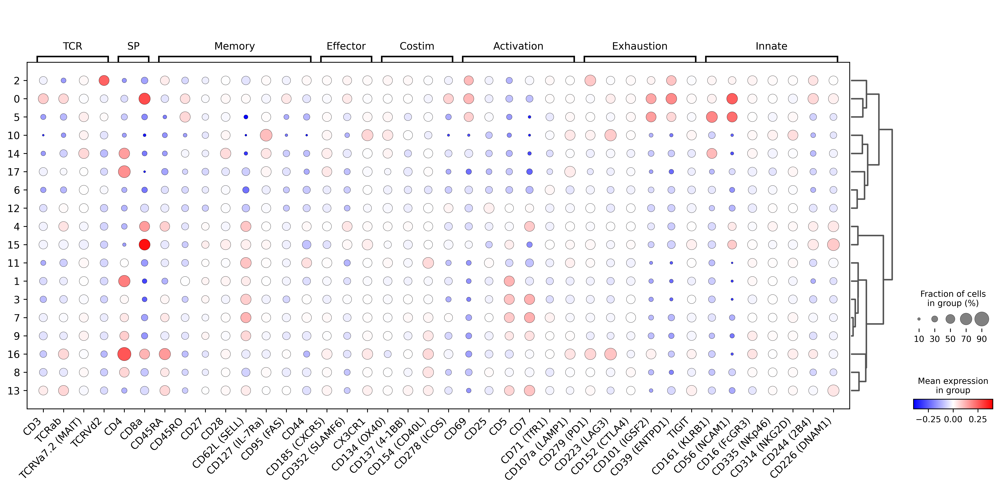

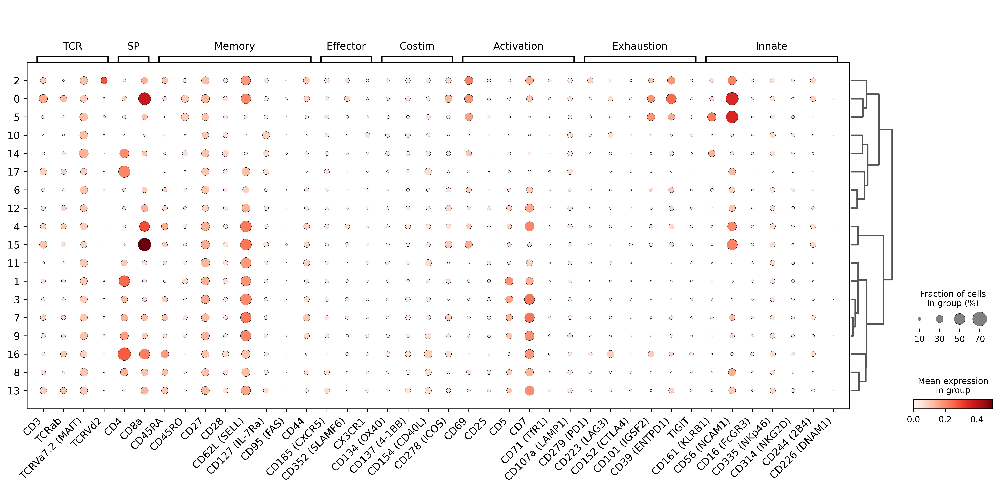

In [ ]:
res = 1.1  # resolution for leiden clustering

adata = mdata_qc["rna"].copy() # type: ignore
adata.X = adata.layers["log1p_zscore"] # type: ignore # use log1p_zscore layer for dendrogram
adata = compute_dendrogram(adata, rna_names, f"leiden_res{res}")  # type: ignore
figdp = sc.pl.dotplot(
    adata,  # type: ignore
    var_names=rna_names,
    groupby=f"leiden_res{res}",
    layer="log1p",
    dendrogram=True,
    cmap="Blues",
    vmin=0,
    # vmax=5,  # set vmin and vmax for better visualization
    title="",
    return_fig=True,
)
rotate_labels(figdp)
fig = plt.gcf()
fig.savefig(
    PATH_FIG_DIR
    / f"dotplot_rna_log1p_leiden_res{res}.{FIG_TYPE}",  # pyright: ignore[reportArgumentType]
    bbox_inches="tight",
    dpi=600,
    transparent=True,
)

figdp = sc.pl.dotplot(
    adata,  # type: ignore
    var_names=rna_names,
    groupby=f"leiden_res{res}",
    layer="log1p_zscore",
    dendrogram=True,
    cmap="bwr",
    vmin=-1,
    vmax=1,
    title="",
    return_fig=True,
)
rotate_labels(figdp)
fig = plt.gcf()
fig.savefig(
    PATH_FIG_DIR
    / f"dotplot_rna_log1p_zscore_leiden_res{res}.{FIG_TYPE}",  # pyright: ignore[reportArgumentType]
    bbox_inches="tight",
    dpi=600,
    transparent=True,
)

adata = compute_dendrogram(mdata_qc["prot"], prot_names2, f"leiden_res{res}")  # type: ignore
figdp = sc.pl.dotplot(
    adata,  # type: ignore
    var_names=prot_names2,
    groupby=f"leiden_res{res}",
    dendrogram=True,
    layer="clr_regressed",  # use the CLR subtracted layer
    cmap="bwr",
    vmin=-0.4,
    vmax=0.4,
    vcenter=0.0,
    title="",
    return_fig=True,
)
rotate_labels(figdp, xticklabels=prot_names2_fixed)
fig = plt.gcf()
fig.savefig(
    PATH_FIG_DIR
    / f"dotplot_protein2_leiden_res{res}.{FIG_TYPE}",  # pyright: ignore[reportArgumentType]
    bbox_inches="tight",
    dpi=600,
    transparent=True,
)

figdp = sc.pl.dotplot(
    adata,  # type: ignore
    var_names=prot_names2,
    groupby=f"leiden_res{res}",
    dendrogram=True,
    layer="prot_thresh2",  # used the CLR subtracted layer
    cmap="Reds",
    vmin=0,
    vmax=0.5,
    vcenter=0.25,
    title="",
    return_fig=True,
)
rotate_labels(figdp, xticklabels=prot_names2_fixed)
fig = plt.gcf()
# display(fig.get_size_inches())  # (14.88, 5.9)
fig.savefig(
    PATH_FIG_DIR
    / f"dotplot_protein2_thresh2_leiden_res{res}.{FIG_TYPE}",  # pyright: ignore[reportArgumentType]
    bbox_inches="tight",
    dpi=600,
    transparent=True,
)

## Differential expression

### RNA

In [ ]:
for res in [1, 1.1]:
    print(f"Running DE for leiden_res{res}")

    # Run differential expression
    sc.tl.rank_genes_groups(
        mdata_qc["rna"],  # type: ignore
        groupby=f"leiden_res{res}",
        key_added=f"rank_genes_leiden_res{res}",
        method="wilcoxon",  # or "wilcoxon" or "logreg"
        layer="log1p",  # use the log1p layer for DE
        use_raw=False,
    )

Running DE for leiden_res1


Running DE for leiden_res1.1


In [ ]:
for res in [1, 1.1]:
    figdp = sc.pl.rank_genes_groups_dotplot(
        mdata_qc["rna"],  # type: ignore
        n_genes=5,  # Number of top genes per group
        groupby=f"leiden_res{res}",
        key=f"rank_genes_leiden_res{res}",
        dendrogram=False,
        min_logfoldchange=0.5,  # Minimum log fold change to consider
        standard_scale="var",  # Standardize by variable
        # use_raw=True,
        layer="log1p",
        cmap="cividis",
        return_fig=True,
    )
    rotate_labels(figdp)
    fig = plt.gcf()
    fig.savefig(
        PATH_FIG_DIR / f"dotplot_rgg_rna_de_leiden_res{res}.{FIG_TYPE}",  # type: ignore
        bbox_inches="tight",
        transparent=True,
        dpi=300,
    )

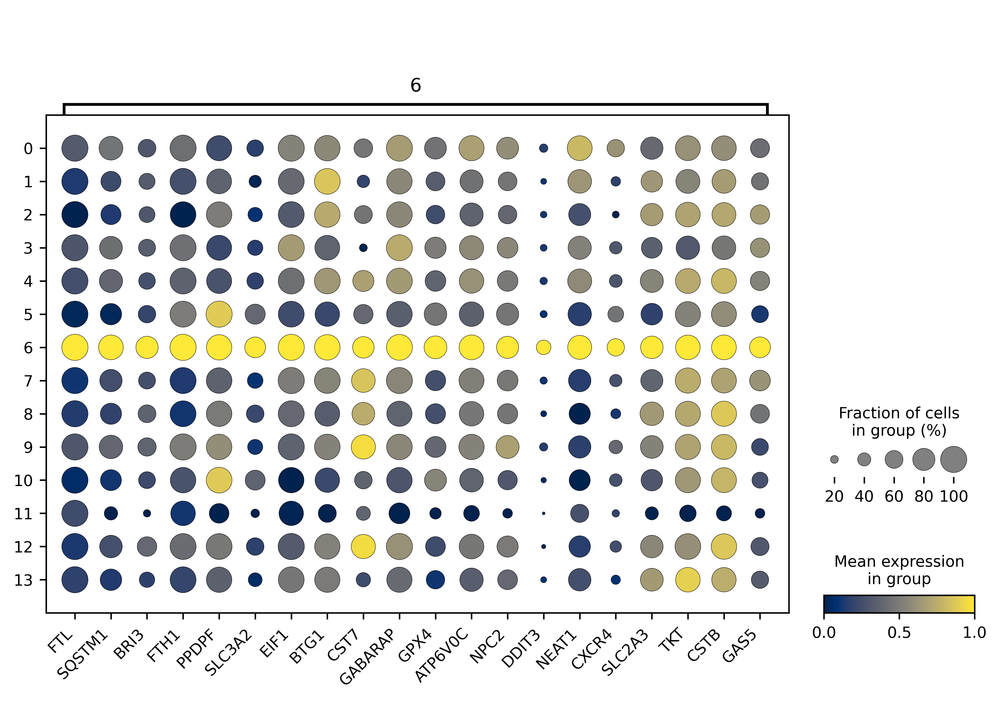

In [ ]:
figdp = sc.pl.rank_genes_groups_dotplot(
    mdata_qc["rna"],  # type: ignore
    n_genes=20,  # Number of top genes per group
    groupby=f"leiden_res1",
    key=f"rank_genes_leiden_res1",
    groups=["6"],
    dendrogram=False,
    min_logfoldchange=0.5,  # Minimum log fold change to consider
    standard_scale="var",  # Standardize by variable
    use_raw=True,
    cmap="cividis",
    return_fig=True,
)
rotate_labels(figdp)
fig = plt.gcf()
fig.savefig(
    PATH_FIG_DIR / f"dotplot_rgg_rna_de_c6_leiden_res1.{FIG_TYPE}",  # type: ignore
    bbox_inches="tight",
    transparent=True,
    dpi=300,
)

### Protein

In [ ]:
for res in [1, 1.1]:

    # ensure group is in protein
    mdata_qc["prot"].obs[f"leiden_res{res}"] = mdata_qc["rna"].obs[f"leiden_res{res}"]

    # Run differential expression
    sc.tl.rank_genes_groups(
        mdata_qc["prot"],  # type: ignore
        groupby=f"leiden_res{res}",
        key_added=f"rank_proteins_leiden_res{res}",
        method="wilcoxon",  # or "wilcoxon" or "logreg"
        use_raw=False,
        layer="prot_thresh2",  # uses the clr_regressed layer
    )

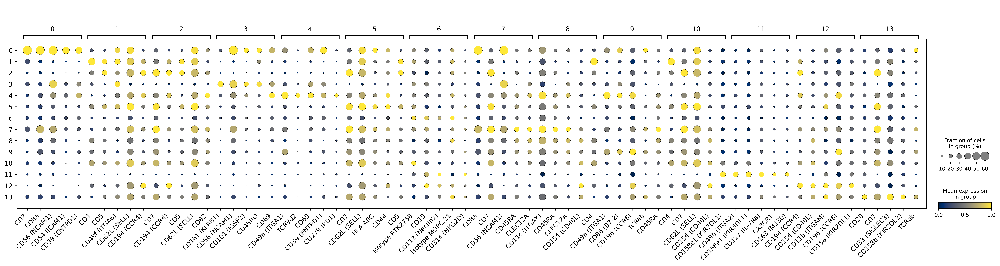

In [ ]:
n_genes = 5

for res in [1, 1.1]:
    prot_list = mdata_qc["prot"].uns[f"rank_proteins_leiden_res{res}"]["names"][:n_genes]
    prot_list_fixed = (
        # np.array([[x for x in entry] for entry in prot_list]).T.flatten().tolist()
        np.array([[namefix[x] for x in entry] for entry in prot_list])
        .T.flatten()
        .tolist()
)

    figdp = sc.pl.rank_genes_groups_dotplot(
        mdata_qc["prot"],  # type: ignore
        n_genes=n_genes,  # Number of top genes per group
        groupby=f"leiden_res{res}",
        key=f"rank_proteins_leiden_res{res}",
        dendrogram=False,
        # min_logfoldchange=0.1,  # Minimum log fold change to consider
        standard_scale="var",  # Standardize by variable
        use_raw=False,
        layer="prot_thresh2",  # uses the clr_regressed layer
        cmap="cividis",
        return_fig=True,
    )
    rotate_labels(figdp, prot_list_fixed)
    fig = plt.gcf()
    fig.savefig(
        PATH_FIG_DIR / f"dotplot_rgg_prot_thresh2_de_leiden_res{res}.{FIG_TYPE}",  # type: ignore
        bbox_inches="tight",
        transparent=True,
        dpi=300,
    )

## Signatures

### Create signature from Park 2020 data

Do it analogously to how Chopp et al 2020 created CD4 and CD8 signatures:

Select genes in CD4 clusters that are $>1.5x$ $log_2$ fold-change above all DP and CD8 clusters
* Vice-versa for CD8 genes/clusters

#### Load Park 2020 data

In [ ]:
adata_park = ad.read_h5ad(PATH_DATA_DIR / "Park2020_Human_Thymus_All_fig1.h5ad")
display(adata_park)

AnnData object with n_obs × n_vars = 255901 × 33694
    obs: 'Anno_level_1', 'Anno_level_2', 'Anno_level_3', 'Anno_level_4', 'Anno_level_5', 'Anno_level_fig1', 'Sample', 'donor', 'organ', 'sort', 'method', 'file', 'Anno_stage', 'Age', 'Gender', 'Source'
    obsm: 'X_umap'

#### Get relevant cluster indices

In [ ]:
# Define the clusters to find
park_clusters = ["CD4+T", "CD4+Tmem", "CD8+T", "CD8+Tmem", "DP(P)", "DP(Q)"]

# Find the indexes of the specified clusters
park_indexes = {}
for cluster in park_clusters:
    park_indexes[cluster] = adata_park.obs.index[
        adata_park.obs["Anno_level_5"] == cluster
    ].tolist()

# display(park_indexes)

park_expression = pd.DataFrame(index=adata_park.var_names, columns=park_clusters)
for cluster, idx in park_indexes.items():
    park_expression[cluster] = np.array(adata_park[idx].X.mean(axis=0)).flatten()  # type: ignore

display(park_expression)

,CD4+T,CD4+Tmem,CD8+T,CD8+Tmem,DP(P),DP(Q)
index,,,,,,
TSPAN6,0.103002,0.014031,0.117302,0.007726,0.134360,0.128715
TNMD,0.000000,0.000000,0.000000,0.000000,0.000137,0.000296
DPM1,0.496960,0.499226,0.503358,0.405913,1.179846,0.582776
SCYL3,0.185980,0.124865,0.149030,0.105437,0.196050,0.149274
C1orf112,0.101125,0.027201,0.069574,0.036594,0.677613,0.059834
...,...,...,...,...,...,...
RP11-157J13.1,0.000000,0.000000,0.000000,0.000000,0.000058,0.000000
LLNLR-245B6.1,0.355292,0.227588,0.430268,0.267978,0.592657,0.428184
CTD-2060L22.1,0.001214,0.007165,0.000605,0.000000,0.005287,0.004690


#### Compute fold-changes

In [ ]:
# Calculate log2 fold-change in non-matching pairs of columns
park_fcs = pd.DataFrame(index=park_expression.index)
for col1 in park_expression.columns:
    for col2 in park_expression.columns:
        if (
            ("CD4" in col1 and "CD4" in col2)
            or ("CD8" in col1 and "CD8" in col2)
            or ("DP" in col1 and "DP" in col2)
        ):
            continue
        else:
            park_fcs[f"{col1}_vs_{col2}"] = np.log2(
                park_expression[col1] / park_expression[col2]
            )

display(park_fcs)

,CD4+T_vs_CD8+T,CD4+T_vs_CD8+Tmem,CD4+T_vs_DP(P),CD4+T_vs_DP(Q),CD4+Tmem_vs_CD8+T,CD4+Tmem_vs_CD8+Tmem,CD4+Tmem_vs_DP(P),CD4+Tmem_vs_DP(Q),CD8+T_vs_CD4+T,CD8+T_vs_CD4+Tmem,...,CD8+Tmem_vs_DP(P),CD8+Tmem_vs_DP(Q),DP(P)_vs_CD4+T,DP(P)_vs_CD4+Tmem,DP(P)_vs_CD8+T,DP(P)_vs_CD8+Tmem,DP(Q)_vs_CD4+T,DP(Q)_vs_CD4+Tmem,DP(Q)_vs_CD8+T,DP(Q)_vs_CD8+Tmem
index,,,,,,,,,,,,,,,,,,,,,
TSPAN6,-0.187555,3.736864,-0.383426,-0.321502,-3.063498,0.860920,-3.259370,-3.197446,0.187554,3.063498,...,-4.120290,-4.058366,0.383426,3.259370,0.195872,4.120290,0.321502,3.197446,0.133948,4.058366
TNMD,NaN,NaN,-inf,-inf,NaN,NaN,-inf,-inf,NaN,NaN,...,-inf,-inf,inf,inf,inf,inf,inf,inf,inf,inf
DPM1,-0.018455,0.291958,-1.247396,-0.229811,-0.011891,0.298522,-1.240832,-0.223247,0.018455,0.011891,...,-1.539354,-0.521770,1.247396,1.240832,1.228941,1.539354,0.229811,0.223247,0.211356,0.521769
SCYL3,0.319551,0.818765,-0.076069,0.317193,-0.255230,0.243984,-0.650850,-0.257588,-0.319551,0.255230,...,-0.894834,-0.501572,0.076069,0.650850,0.395620,0.894834,-0.317193,0.257588,0.002359,0.501572
C1orf112,0.539511,1.466449,-2.744324,0.757102,-1.354907,-0.427969,-4.638741,-1.137316,-0.539511,1.354907,...,-4.210773,-0.709347,2.744324,4.638741,3.283834,4.210773,-0.757102,1.137316,-0.217592,0.709347
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
RP11-157J13.1,NaN,NaN,-inf,NaN,NaN,NaN,-inf,NaN,NaN,NaN,...,-inf,NaN,inf,inf,inf,inf,NaN,NaN,NaN,NaN
LLNLR-245B6.1,-0.276232,0.406892,-0.738192,-0.269225,-0.918815,-0.235691,-1.380775,-0.911808,0.276232,0.918815,...,-1.145084,-0.676118,0.738192,1.380775,0.461960,1.145084,0.269225,0.911808,-0.007007,0.676118
CTD-2060L22.1,1.004163,inf,-2.122370,-1.949587,3.565100,inf,0.438567,0.611350,-1.004163,-3.565100,...,-inf,-inf,2.122370,-0.438567,3.126533,inf,1.949587,-0.611350,2.953750,inf


#### Extract CD4 and CD8 signatures

In [ ]:
# Initialize True masks the size of the gene index
gene_mask_cd4 = np.ones(len(park_fcs), dtype=bool)
gene_mask_cd8 = np.ones(len(park_fcs), dtype=bool)

for x in park_fcs.columns:
    if "CD4" in x.split("_")[0]:  # Check if the comparison starts with "CD4"
        gene_mask_cd4 &= park_fcs[x] > 1.5  # Keep the mask True for genes > 1.5
    if "CD8" in x.split("_")[0]:  # Check if the comparison starts with "CD8"
        gene_mask_cd8 &= park_fcs[x] > 1.5  # Keep the mask True for genes > 1.5

signatures_park_new = {
    "Park CD4": park_fcs.index[gene_mask_cd4].tolist(),
    "Park CD8": park_fcs.index[gene_mask_cd8].tolist(),
}

display(signatures_park_new)
for sig in signatures_park_new:
    print(f"{sig}: {len(signatures_park_new[sig])} genes")

# Pad the signatures to equal size and convert to a DataFrame for saving
max_len = max(len(v) for v in signatures_park_new.values())
signatures_park_new_df = pd.DataFrame(
    {k: v + [None] * (max_len - len(v)) for k, v in signatures_park_new.items()}
)
signatures_park_new_df.to_csv(
    PATH_DATA_DIR / "Park2020_Signatures_New.csv", index=False
)

### Create signatures from Conde 2022 DEGs

#### Load Conde 2022 data

In [ ]:
adata_conde = ad.read_h5ad(
    PATH_DATA_DIR / f"Conde2022_t-cells.h5ad",
)
display(adata_conde)

AnnData object with n_obs × n_vars = 216611 × 36601
    obs: 'Organ', 'Donor', 'Chemistry', 'Predicted_labels_CellTypist', 'Majority_voting_CellTypist', 'Manually_curated_celltype'
    obsm: 'X_umap'

#### Rank genes per cluster

In [ ]:
# Perform differential gene expression analysis for clusters in Conde adata
sc.tl.rank_genes_groups(
    adata_conde,
    groupby="Manually_curated_celltype",  # Replace with the column name for clusters
    method="wilcoxon",  # You can also use "t-test" or "logreg"
    use_raw=False,  # Use raw data if available
)

#### Visualize top genes

In [ ]:
figdp = sc.pl.rank_genes_groups_dotplot(
    adata_conde,  # type: ignore
    n_genes=5,  # Number of top genes per group
    groupby=f"Manually_curated_celltype",
    dendrogram=False,
    min_logfoldchange=0.5,  # Minimum log fold change to consider
    standard_scale="var",  # Standardize by variable
    use_raw=False,
    cmap="cividis",
    return_fig=True,
)
rotate_labels(figdp)
fig = plt.gcf()
fig.savefig(
    PATH_FIG_DIR / f"dotplot_rgg_rna_de_cell_type_Conde2022.{FIG_TYPE}",  # type: ignore
    bbox_inches="tight",
    transparent=True,
    dpi=300,
)

#### Export signatures

In [ ]:
# Convert DEGs to a list
conde_ranked_genes = np.array(
    [list(x) for x in adata_conde.uns["rank_genes_groups"]["names"]]
)
conde_ranked_genes = np.array(conde_ranked_genes)
conde_cluster_names = adata_conde.uns["rank_genes_groups"]["names"].dtype.names
# display(conde_ranked_genes)

# Extract the top 50 genes for each cluster
conde_top_genes_per_cluster = pd.DataFrame(
    conde_ranked_genes[:50, :], columns=conde_cluster_names
)
display(conde_top_genes_per_cluster)

# Save the result to a CSV file
output_path = PATH_DATA_DIR / "Conde2022_Signatures_New.csv"
conde_top_genes_per_cluster.to_csv(output_path, index=False)

### Input + process signatures

In [ ]:
signatures_excel_file = pd.ExcelFile(PATH_DATA_DIR / f"Table SV - Gene Signatures.xlsx")

nonzero_genes = mdata_qc["rna"].var_names[np.array(mdata_qc["rna"].layers["log1p"].sum(axis=0) > 0).flatten()].tolist()  # type: ignore
# display(nonzero_genes)
display(len(nonzero_genes))

19500

In [ ]:
# Simple gene checker code

# goi = "CLDN1"
goi = "AC093063.2"
display(goi in nonzero_genes)
if goi in nonzero_genes:
    goi_sum = np.array(mdata_qc["rna"][:, goi].layers["log1p"].sum(axis=0)).sum()  # type: ignore
    display(goi_sum)

False

#### T-cell 4SP and 8SP signatures

In [ ]:
signatures_sp = {}  # Pooled major signatures
signatures_sp_degs = {}  # Pooled signatures from DEGs

# Schmiedel et al. 2018 (Vijayanand lab - based on sorted bulk RNA-seq log2 FC > 2 for Naive CD4 and Naive CD8)
df_schmiedel = pd.read_excel(signatures_excel_file, "Schmiedel2018", header=0)

signatures_sp["Schmiedel CD4"] = np.intersect1d(
    df_schmiedel[["Naive CD4"]].dropna().to_numpy().flatten(),
    nonzero_genes,
)
signatures_sp["Schmiedel CD8"] = np.intersect1d(
    df_schmiedel[["Naive CD8"]].dropna().to_numpy().flatten(),
    nonzero_genes,
)

# Grab SP signatures separately
signatures_sp_schmiedel = {
    "Schmiedel CD4": signatures_sp["Schmiedel CD4"],
    "Schmiedel CD8": signatures_sp["Schmiedel CD8"],
}


# Chopp et al. 2020 (Bosselut lab - based on differences btw 4v8 during DP --> SP transition)
df_chopp = pd.read_excel(signatures_excel_file, "Chopp2020", header=0)

signatures_sp["Chopp CD4"] = np.intersect1d(
    df_chopp[["Chopp CD4"]].dropna().to_numpy().flatten(),
    nonzero_genes,
)
signatures_sp["Chopp CD8"] = np.intersect1d(
    df_chopp[["Chopp CD8"]].dropna().to_numpy().flatten(),
    nonzero_genes,
)

# Grab SP signatures separately
signatures_sp_chopp = {
    "Chopp CD4": signatures_sp["Chopp CD4"],
    "Chopp CD8": signatures_sp["Chopp CD8"],
}

# Combine select signatures and filter out anything not in our dataset
signatures_sp_degs["Chopp CD4 DEGs"] = np.intersect1d(
    np.unique(df_chopp[["hs-ImCD4", "hs-MatCD4"]].dropna().to_numpy().flatten()),
    nonzero_genes,
)
signatures_sp_degs["Chopp CD8 DEGs"] = np.intersect1d(
    np.unique(
        df_chopp[["hs-ImCD8", "hs-MatCD8", "hs-CD8"]].dropna().to_numpy().flatten()
    ),
    nonzero_genes,
)

# Grab all signatures separately
signatures_chopp = {
    "Chopp "
    + key: np.intersect1d(
        df_chopp[key].dropna().to_numpy().flatten(),
        nonzero_genes,
    )
    for key in [
        "hs-ImCD4",
        "hs-MatCD4",
        "hs-ImCD8",
        "hs-MatCD8",
        "hs-CD8",
    ]
}


# Park et al. 2020 (Teichmann lab - based on cluster top genes)
df_park = pd.read_excel(signatures_excel_file, "Park2020", header=0)

signatures_sp["Park CD4"] = np.intersect1d(
    df_park[["Park CD4"]].dropna().to_numpy().flatten(),
    nonzero_genes,
)
signatures_sp["Park CD8"] = np.intersect1d(
    df_park[["Park CD8"]].dropna().to_numpy().flatten(),
    nonzero_genes,
)

# Grab SP signatures separately
signatures_sp_park = {
    "Park CD4": signatures_sp["Park CD4"],
    "Park CD8": signatures_sp["Park CD8"],
}

# Combine select signatures and filter out anything not in our dataset
signatures_sp_degs["Park CD4 DEGs"] = np.intersect1d(
    np.unique(df_park[["CD4+T", "CD4+Tmem"]].dropna().to_numpy().flatten()),
    nonzero_genes,
)
signatures_sp_degs["Park CD8 DEGs"] = np.intersect1d(
    np.unique(df_park[["CD8+T", "CD8+Tmem"]].dropna().to_numpy().flatten()),
    nonzero_genes,
)

# Grab all signatures separately
signatures_park = {
    "Park "
    + key: np.intersect1d(
        df_park[key].dropna().to_numpy().flatten(),
        nonzero_genes,
    )
    for key in [
        "CD4+CTL",
        "CD4+PD1",
        "CD4+T",
        "CD4+Tmem",
        "CD8+T",
        "CD8+Tmem",
        "gdT",
        "CD8aa(I)",
        "CD8aa(II)",
        "NK",
        "ILC3",
        "NKT",
        "T(agonist)",
        "Tfh",
        "Th17",
        "Treg",
        "Treg(diff)",
    ]
}


# Jones et al. 2025 (current work) - based on manual curation and compring DEGs in CD4 vs CD8 clusters of Park et al. 2020
df_jones = pd.read_excel(signatures_excel_file, "Jones2025", header=0)
signatures_sp["Jones CD4"] = np.intersect1d(
    np.unique(df_jones[["Jones CD4 v2"]].dropna().to_numpy().flatten()),
    nonzero_genes,
)
signatures_sp["Jones CD8"] = np.intersect1d(
    np.unique(df_jones[["Jones CD8"]].dropna().to_numpy().flatten()),
    nonzero_genes,
)

# Grab SP signatures separately
signatures_sp_jones = {
    "Jones CD4": signatures_sp["Jones CD4"],
    "Jones CD8": signatures_sp["Jones CD8"],
}

display(signatures_sp)
display(signatures_sp_schmiedel)
display(signatures_sp_chopp)
display(signatures_sp_park)
display(signatures_sp_jones)
display(signatures_park)

#### Generate Union CD4 and CD8 signatures

In [ ]:
# take union of signatures
union_cd4 = np.unique(
    np.union1d(
        signatures_sp_degs["Chopp CD4 DEGs"],
        signatures_sp_degs["Park CD4 DEGs"],
    )
)
union_cd8 = np.unique(
    np.union1d(
        signatures_sp_degs["Chopp CD8 DEGs"],
        signatures_sp_degs["Park CD8 DEGs"],
    )
)

# Remove genes that are in both CD4 and CD8 signatures (robust to order by comparing to original sets)
signatures_sp["Union CD4"] = np.setdiff1d(union_cd4, union_cd8)
signatures_sp["Union CD8"] = np.setdiff1d(union_cd8, union_cd4)

display(
    {
        "Union CD4": signatures_sp["Union CD4"],
        "Union CD8": signatures_sp["Union CD8"],
    }
)

{'Union CD4': array(['ADD3', 'AP3M2', 'ARMH1', 'BACH2', 'CAMK4', 'CCR6', 'CD40LG',
        'CORO1B', 'CTSL', 'CYLD', 'DENND2D', 'EMP3', 'FCGRT', 'FXYD5',
        'GIMAP4', 'GPR183', 'GSTK1', 'HPGD', 'IFITM2', 'IL27RA', 'ITM2A',
        'KLF2', 'KLRB1', 'LTB', 'MAL', 'MSL3', 'NDFIP1', 'NOSIP', 'PRMT2',
        'RIPOR2', 'RNASET2', 'RORA', 'RPL17', 'RPL36A', 'SAMD3', 'SATB1',
        'SCML1', 'SCML4', 'SELENOW', 'SLC2A3', 'STAT5A', 'SYTL2', 'TC2N',
        'THOC7', 'TMSB10', 'TTC39C'], dtype=object),
 'Union CD8': array(['ACTN1', 'AOAH', 'CCL4', 'CCL5', 'CD248', 'CD55', 'CD7', 'CD8A',
        'CD8B', 'CLEC2D', 'COTL1', 'CRTAM', 'CST7', 'CTSW', 'CYTIP',
        'DUSP2', 'EGR1', 'FTL', 'GZMK', 'GZMM', 'HCST', 'HLA-DPB1', 'ICOS',
        'ID3', 'LDLRAP1', 'LINC00861', 'LINC02446', 'LRRN3', 'LYAR',
        'MT2A', 'MYC', 'NAB2', 'NELL2', 'NKG7', 'NR4A1', 'PASK', 'PAXX',
        'PDE3B', 'PECAM1', 'PLAC8', 'PTGER4', 'PTPN6', 'RAP1A', 'RPL13',
        'RPLP0', 'RPLP1', 'RPS10', 'RPS18', 'RPS19

#### Functional Signatures

In [ ]:
# From Mazziota et al 2025 (Chapuis lab - they were looking at CD8+ T cell states in AML)
df_mazziotta = pd.read_excel(signatures_excel_file, "Mazziotta2025", header=0)
signatures_func = {
    key: np.intersect1d(
        df_mazziotta[key].dropna().to_numpy().flatten(),
        nonzero_genes,
    )
    for key in df_mazziotta.columns
}

# Remove WT1 TCR+ T cell signature "TCR_C4"
signatures_func.pop("TCR_C4", None)
signatures_func

{'Naive CM-like': array(['ABLIM1', 'BCL2', 'CAMK4', 'CCR7', 'CD55', 'CD69', 'DGKA',
        'EEF1A1', 'EEF1B2', 'EIF3E', 'EIF3L', 'FHIT', 'FLT3LG', 'FOXP1',
        'IL7R', 'INPP4B', 'KLF2', 'LDHB', 'LEF1', 'LEPROTL1', 'LTB', 'MYC',
        'NELL2', 'NFKBIZ', 'NOSIP', 'NPM1', 'OXNAD1', 'PABPC1', 'PASK',
        'PCED1B', 'PIK3IP1', 'PIM1', 'PIM2', 'PLP2', 'RCAN3', 'SARAF',
        'SATB1', 'SELL', 'SERINC5', 'SESN3', 'SNHG8', 'SNX9', 'SOCS3',
        'SPINT2', 'TCF7', 'TMEM123', 'TNFSF8', 'TPT1', 'TRABD2A', 'TXK',
        'VIM'], dtype=object),
 'CD45RO+ EM': array(['ARL4C', 'BTG1', 'CD27', 'CD74', 'COTL1', 'CREM', 'CSRNP1',
        'CXCR4', 'DNAJB1', 'DUSP1', 'DUSP2', 'EML4', 'FOS', 'FYN',
        'GABARAPL1', 'GZMK', 'IDI1', 'IFNGR1', 'ISG20', 'JUN', 'JUNB',
        'KLRB1', 'MAP3K8', 'MCL1', 'NR4A2', 'PDE4B', 'PIK3IP1', 'PMAIP1',
        'PPP1R15A', 'PPP2R5C', 'PTGER4', 'RGS1', 'RHOH', 'RSL24D1',
        'SLC2A3', 'SPOCK2', 'TNFAIP3', 'TSPYL2', 'ZFP36', 'ZFP36L2',
        'ZNF331'],

#### De-duplicate functional signatures

Not done

In [ ]:
# # De-duplicate functional gene signatures
# def remove_overlaps(signats_dict, signat_names):
#     unique_genes = set()
#     signats_dict_dedup = deepcopy(signats_dict)
#     for signat in signat_names:
#         genes = []
#         for gene in signats_dict[signat]:
#             if gene not in unique_genes:
#                 genes.append(gene)
#                 unique_genes.add(gene)
#         signats_dict_dedup[signat] = np.array(genes)
#     return signats_dict_dedup


# signatures_func_unique = remove_overlaps(
#     signatures_func_filt, signatures_func_filt.keys()
# )

#### Filter Union sigs for func sig genes

In [ ]:
signatures_sp_unions = {
    k: v for k, v in signatures_sp.items() if k in ["Union CD4", "Union CD8"]
}

signat_func_genes_all = list(
    set(
        [
            gene
            for sublist in [signatures_func[x] for x in signatures_func]
            for gene in sublist
        ]
    )
)

# Find intersection with Union CD4
intersection_cd4 = np.intersect1d(
    signat_func_genes_all, signatures_sp_unions["Union CD4"]
)

# Find intersection with Union CD8
intersection_cd8 = np.intersect1d(
    signat_func_genes_all, signatures_sp_unions["Union CD8"]
)

display(intersection_cd4)
display(intersection_cd8)

array(['CAMK4', 'DENND2D', 'EMP3', 'KLF2', 'KLRB1', 'LTB', 'NOSIP',
       'SATB1', 'SLC2A3'], dtype=object)

array(['CCL4', 'CD55', 'COTL1', 'CST7', 'DUSP2', 'GZMK', 'HLA-DPB1',
       'MYC', 'NELL2', 'NKG7', 'PASK', 'PTGER4', 'SAT1', 'SNX9', 'ZFP36',
       'ZFP36L2'], dtype=object)

In [ ]:
# Remove generic naive T cell genes since many are found in the Union signatures, esp CD4 one
signatures_sp_unions["Union CD4"] = np.setdiff1d(
    signatures_sp_unions["Union CD4"],
    signatures_func["Naive CM-like"],  # signat_func_genes_all
)
signatures_sp_unions["Union CD8"] = np.setdiff1d(
    np.setdiff1d(
        signatures_sp_unions["Union CD8"], signatures_func["Naive CM-like"]
    ),  # signat_func_genes_all),
    [
        "CD8A",
        "CD8B",
        "CD7",
    ],  # Manually remove CD8a/b to reduce circularity, remove CD7 because it's nonspecific
)

# Write to signatures file
max_len = max(
    len(signatures_sp_unions["Union CD4"]), len(signatures_sp_unions["Union CD8"])
)
union_df = pd.DataFrame(
    {
        "Union CD4": np.pad(
            signatures_sp_unions["Union CD4"],
            (0, max_len - len(signatures_sp_unions["Union CD4"])),
            constant_values="",
        ),
        "Union CD8": np.pad(
            signatures_sp_unions["Union CD8"],
            (0, max_len - len(signatures_sp_unions["Union CD8"])),
            constant_values="",
        ),
    }
)

# Write out to CSV then manually insert into .xlsx file later due to issues w/ overwriting
union_df.to_csv(PATH_DATA_DIR / "Unions_CD4_CD8_Signature_Genes.csv", index=False)

for sig in signatures_sp_unions:
    print(f"{sig}: {len(signatures_sp_unions[sig])} genes")

# Re-apply to signatures_sp collection
for key in signatures_sp_unions.keys():
    signatures_sp[key] = signatures_sp_unions[key]

Union CD4: 41 genes
Union CD8: 52 genes


#### Save finalized signature lists

In [ ]:
# Save processed signatures as pkl file
signatures_final_dict = {
    'func': signatures_func,
    'sp': signatures_sp,
    'sp_degs': signatures_sp_degs,
    'sp_unions': signatures_sp_unions,
    'sp_jones': signatures_sp_jones,
    'sp_chopp': signatures_sp_chopp,
    'chopp': signatures_chopp,
    'sp_schmiedel': signatures_sp_schmiedel,
    'sp_park': signatures_sp_park,
    'park': signatures_park,
}
with open(PATH_DATA_DIR / "Processed_Signatures.pkl", "wb") as f:
    pickle.dump(signatures_final_dict, f)

#### Collect general score names

In [ ]:
# Collect all score names
score_names_gen_func = [f"{name}_score" for name in signatures_func.keys()]
score_names_gen_sp = [f"{name}_score" for name in signatures_sp.keys()]
score_names_gen_sp_degs = [f"{name}_score" for name in signatures_sp_degs.keys()]
score_names_gen_sp_unions = [f"{name}_score" for name in signatures_sp_unions.keys()]
score_names_gen_sp_jones = [f"{name}_score" for name in signatures_sp_jones.keys()]
score_names_gen_sp_chopp = [f"{name}_score" for name in signatures_sp_chopp.keys()]
score_names_gen_chopp = [f"{name}_score" for name in signatures_chopp.keys()]
score_names_gen_sp_schmiedel = [f"{name}_score" for name in signatures_sp_schmiedel.keys()]
score_names_gen_sp_park = [f"{name}_score" for name in signatures_sp_park.keys()]
score_names_gen_park = [f"{name}_score" for name in signatures_park.keys()]
score_names_gen_park_4v8 = [
    f"{name}_score"
    for name in signatures_park.keys()
    if any(s in name for s in ["CD4+T", "CD8+T"])
]
score_names_gen_park_innate = [
    f"{name}_score"
    for name in signatures_park.keys()
    if any(s in name for s in ["CD8aa", "gdT", "NK", "ILC3", "NKT"])
]
score_names_gen_park_th = [
    f"{name}_score"
    for name in signatures_park.keys()
    if any(s in name for s in ["Tfh", "Th17", "Treg", "Treg(diff)"])
]
score_names_gen_park_cd4_extra = [
    f"{name}_score"
    for name in signatures_park.keys()
    if any(s in name for s in ["CD4+CTL", "CD4+PD1"])
]   

score_names_general_dict = {
    "functional": score_names_gen_func,
    "sp": score_names_gen_sp,
    "sp-degs": score_names_gen_sp_degs,
    "sp-unions": score_names_gen_sp_unions,
    "sp-jones": score_names_gen_sp_jones,
    "sp-chopp": score_names_gen_sp_chopp,
    "chopp": score_names_gen_chopp,
    "sp-schmiedel": score_names_gen_sp_schmiedel,
    "sp-park": score_names_gen_sp_park,
    "park": score_names_gen_park,
    "park_4v8": score_names_gen_park_4v8,
    "park_innate": score_names_gen_park_innate,
    "park_th": score_names_gen_park_th,
    "park_cd4_extra": score_names_gen_park_cd4_extra,
}

with open(PATH_DATA_DIR / "Score_Names_General.pkl", "wb") as f:
    pickle.dump(score_names_general_dict, f)

### Compute signature scores

#### Scanpy standard score_genes()

In [ ]:
for layer in ["log1p", "log1p_zscore", "ccreg"]:

    print(f"Computing signature scores for layer: {layer}")

    for signatures in [
        signatures_func,
        signatures_sp,
        signatures_chopp,
        signatures_park,
    ]:

        # Compute scores for each gene set (average Z-score of genes in signature, relateive to the rest of the genes)
        for signature, gene_list in signatures.items():

            sc.tl.score_genes(
                mdata_qc["rna"],  # type: ignore
                gene_list,
                layer=layer,
                score_name=f"{signature}_sc_{layer}_score",
                return_ctrls=False,
                # use_raw=False  # use ccreg z-scored data (.X)
            )

            # Optional update of mdata_annotated here rather than going through the normal code
            mdata_annotated["rna"].obs[f"{signature}_sc_{layer}_score"] = mdata_qc["rna"].obs[f"{signature}_sc_{layer}_score"]  # type: ignore

print("Finished computing signature scores")

Computing signature scores for layer: log1p
Computing signature scores for layer: log1p_zscore
Computing signature scores for layer: ccreg
Finished computing signature scores


#### All sig genes-based control

In [ ]:
# Quick code to show distrbution of average expression for different layers
# --> log1p_zscore and ccreg are both z-scored for each gene across cells, so are near-0
#   --> (nonzero ones are likely due to capping |score values| at 10)

fig, axs = plt.subplots(1, 3, figsize=[6, 2])

bins = [
    np.linspace(-1, 10, 25),
    np.linspace(-0.025, 0.005, 25),
    np.linspace(-0.025, 0.005, 25),
]
for i, layer in enumerate(["log1p", "log1p_zscore", "ccreg"]):
    x = np.array(mdata_qc["rna"][:, gene_list_all].layers[layer].mean(axis=0)).flatten()  # type: ignore
    axs[i].hist(x, bins=bins[i])

In [ ]:
# Combine all genes from all signatures to use for filtering out
gene_list_all = []
for signatures in [signatures_func, signatures_sp, signatures_chopp, signatures_park]:
    for gene_list in signatures.values():
        gene_list_all.extend(gene_list)

gene_list_all = list(set(gene_list_all))  # unique genes only
display(len(gene_list_all))

means_controls = {}
layer = "log1p"  # the binning method in score_genes() is illogical for z-scored (scaled) data, so use log1p and apply to other layers later
_, control_genes, means_controls_log1p = sc.tl.score_genes(
    mdata_qc["rna"],  # type: ignore
    gene_list_all,
    layer=layer,
    score_name="all_signatures_score",
    copy=True,
    return_ctrls=True,
    ctrl_as_ref=False,  # Do not include gene_list in control genes (prior to subsampling bins)
)

# Apply to each layers
for layer in ["log1p", "log1p_zscore", "ccreg"]:
    means_controls[layer] = pd.DataFrame(
        mdata_qc["rna"][:, control_genes].layers[layer].mean(axis=1),  # type: ignore
        index=mdata_qc["rna"].obs_names,
        columns=["mean_control_genes"],
    )

# Save control genes
pd.DataFrame(control_genes, columns=["control_genes"]).to_csv( # type: ignore
    PATH_DATA_DIR / "sc-all_control_genes.csv", index=False
)  

# Write means_controls to an Excel file, each layer as a separate sheet
with pd.ExcelWriter(PATH_DATA_DIR / "sc-all_means_controls.xlsx") as writer:
    for layer, df in means_controls.items():
        df.to_excel(writer, sheet_name=layer)

display(control_genes)
display(means_controls_log1p)
display(means_controls)
display(len(means_controls["log1p"]))

In [ ]:
for layer in ["log1p", "log1p_zscore", "ccreg"]:

    for signatures in [
        signatures_func,
        signatures_sp,
        signatures_chopp,
        signatures_park,
    ]:

        # Compute scores for each gene set (average Z-score of genes in signature, relateive to the rest of the genes)
        for signature, gene_list in signatures.items():

            means_gene_list = pd.DataFrame(
                mdata_qc["rna"][:, gene_list].layers[layer].mean(axis=1),  # type: ignore
                index=mdata_qc["rna"].obs_names,
            )  # DataFrame conversion for cleaner matrix operations
            mdata_qc["rna"].obs[f"{signature}_sc-all_{layer}_score"] = means_gene_list.values - means_controls[layer].values  # type: ignore

            # Optional update of mdata_annotated here rather than going through the normal code
            mdata_annotated["rna"].obs[f"{signature}_sc-all_{layer}_score"] = mdata_qc["rna"].obs[f"{signature}_sc-all_{layer}_score"]  # type: ignore

#### Mean zscores

In [ ]:
for layer in ["log1p", "log1p_zscore", "ccreg"]:
    for signatures in [
        signatures_func,
        signatures_sp,
        signatures_chopp,
        signatures_park,
    ]:
        for signature, gene_list in signatures.items():

            # OLD IDEA
            # # Generally use cell cycle regression when assessing genes so that prolif markers don't affect score
            # # except in the memory/prolif signature, where we want to actively see how prolif genes are expressed
            # layer = "log1p_zscore" if signature == "Tmem/prolif" else "ccreg"
            # layer = "log1p_zscore"

            mdata_qc["rna"].obs[f"{signature}_mean_{layer}_score"] = mdata_qc["rna"][:, gene_list].layers[layer].mean(axis=1)  # type: ignore

            # Optional update of mdata_annotated here rather than going through the normal code
            mdata_annotated["rna"].obs[f"{signature}_mean_{layer}_score"] = mdata_qc["rna"].obs[f"{signature}_mean_{layer}_score"]  # type: ignore

#### Plot all signature scores for each cluster

##### Standard heatmap

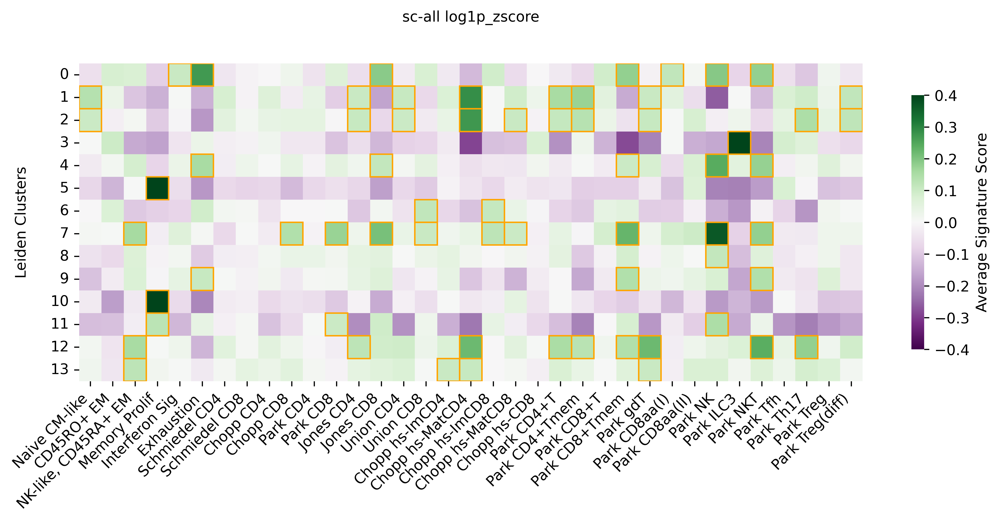

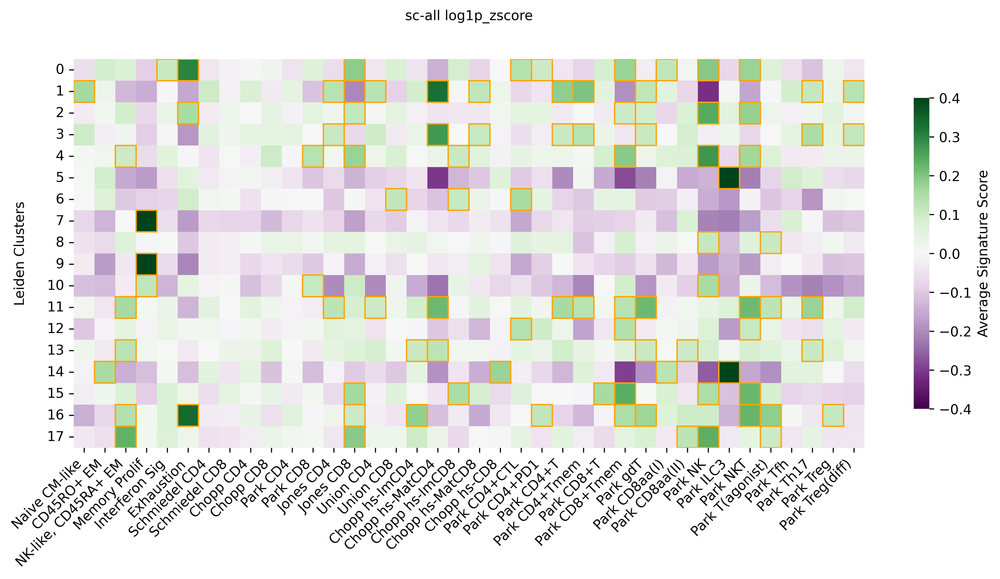

In [ ]:
# ylpads = [-10, 15, -5]
ylpad = 15

for res, H, W in zip([1, 1.1], [4, 5.25], [12, 13]): #13.5]):

    for layer in ["log1p_zscore"]:# ,"log1p", "ccreg"]:

        if layer == "log1p":
            cmap = "PRGn"
            vmin = -2
            vmax = 2
            box_thresh = 1
        else:
            cmap = "PRGn"
            vmin = -0.4
            vmax = 0.4
            box_thresh = 0.1

        for mode in ["sc-all"]: #"mean"]:

            # Get score names
            score_names_func = [
                x.replace("_score", f"_{mode}_{layer}_score")
                for x in score_names_gen_func
            ]
            score_names_sp = [
                x.replace("_score", f"_{mode}_{layer}_score")
                for x in score_names_gen_sp
            ]
            score_names_chopp = [
                x.replace("_score", f"_{mode}_{layer}_score")
                for x in score_names_gen_chopp
            ]
            score_names_park = [
                x.replace("_score", f"_{mode}_{layer}_score")
                for x in score_names_gen_park
            ]
            score_names_park_4v8 = [
                x.replace("_score", f"_{mode}_{layer}_score")
                for x in score_names_gen_park_4v8
            ]
            score_names_park_innate = [
                x.replace("_score", f"_{mode}_{layer}_score")
                for x in score_names_gen_park_innate
            ]
            score_names_park_th = [
                x.replace("_score", f"_{mode}_{layer}_score")
                for x in score_names_gen_park_th
            ]

            if res == 1:
                final_columns = (
                    score_names_func
                    + score_names_sp
                    + score_names_chopp
                    + score_names_park_4v8
                    + score_names_park_innate
                    + score_names_park_th
                )
            else: # add additional CD4+CTL and CD4+PD1 signatures for higher res
                final_columns = (
                    score_names_func
                    + score_names_sp
                    + score_names_chopp
                    + score_names_park
                )
            column_labels = [x.split("_")[0] for x in final_columns]

            # Compute cluster-level signature score matrix
            cluster_signature_mean = (
                mdata_qc["rna"]
                # .obs.groupby(f"leiden_res{res}")[score_names_4v8 + score_names_func]
                .obs.groupby(f"leiden_res{res}")[final_columns].mean()
            )

            # Reorder full matrix
            # cluster_signature_matrix = cluster_signature_matrix.iloc[row_order, :]
            cluster_signature_mean = cluster_signature_mean.loc[:, final_columns]
            cluster_signature_mean.columns = column_labels

            index_init = cluster_signature_mean.index

            # Apply Z-score normalization for each row in non-scaled log1p data
            if layer == "log1p":
                cluster_signature_mean = cluster_signature_mean.apply(
                    lambda x: (x - x.mean()) / x.std(), axis=0
                )

            # display(cluster_signature_mean)

            # Plot heatmap
            # fig, ax = plt.subplots(1, 1, figsize=(0.666, 3.7))
            # fig, ax = plt.subplots(1, 1, figsize=(15.75, 5.25))
            fig, ax = plt.subplots(1, 1, figsize=(W, H))
            # Create a gridspec with space for the colorbar on top
            sns.heatmap(
                # g = sns.clustermap(
                data=cluster_signature_mean,
                ax=ax,
                cmap=cmap,
                vmin=vmin,
                vmax=vmax,
                xticklabels=column_labels,
                yticklabels=list(index_init),
                # cbar=True,
                cbar_kws={
                    "label": "Average Signature Score",
                    # "label_rot": -90,
                    # "pad": ylpad,
                    "shrink": 0.8,
                },
            )

            # Loop through each signature row and celltype col for boxes
            # celltype_thresh = celltype_signature_mean > box_thresh
            for i, (rowname, row) in enumerate(
                # cluster_signature_mean_ordered.iterrows()
                cluster_signature_mean.iterrows()
            ):

                for j, col in enumerate(row):
                    # Draw a box around the signature if it is above a threshold
                    if col > box_thresh:
                        rect = plt.Rectangle(  # type: ignore
                            (j, i), 1, 1, fill=False, edgecolor="orange", linewidth=1
                        )
                        ax.add_patch(rect)

            ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha="right")
            ax.set_yticklabels(ax.get_yticklabels(), rotation=0, ha="right")

            ax.set_xlabel("")
            ax.set_ylabel("Leiden Clusters", rotation=90, labelpad=ylpad)
            ax.set_title(f"{mode} {layer}\n\n")

            # Save figure
            fig.savefig(
                PATH_FIG_DIR
                / f"cluster_signature_heatmap_all_leiden_res{res}_{mode}_{layer}.{FIG_TYPE}",  # type: ignore
                bbox_inches="tight",
                transparent=True,
            )

##### Clustermaps

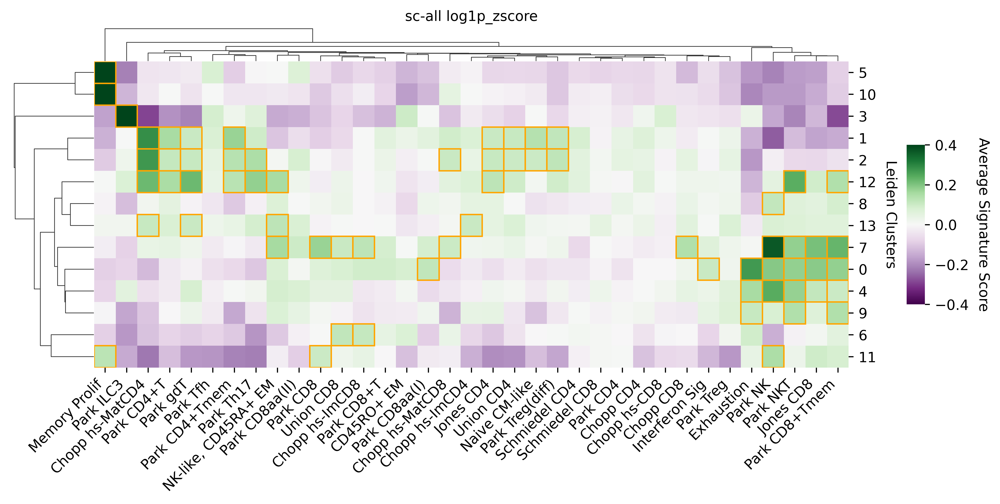

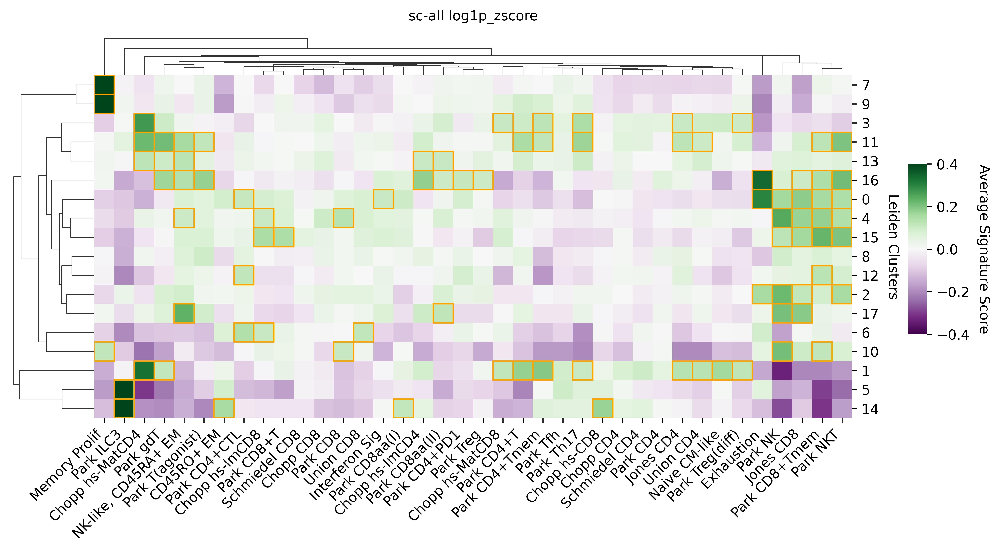

In [ ]:
# ylpads = [-10, 15, -5]
ylpad = 15

for res, H, W in zip([1, 1.1], [5.25, 5.75], [9, 9.25]):

    for layer in ["log1p_zscore"]: #, "log1p", "ccreg"]:

        if layer == "log1p":
            cmap = "PRGn"
            vmin = -2
            vmax = 2
            box_thresh = 1
        else:
            cmap = "PRGn"
            vmin = -0.4
            vmax = 0.4
            box_thresh = 0.1

        for mode in ["sc-all"]:#, "mean"]:

            # Get score names
            score_names_func = [
                x.replace("_score", f"_{mode}_{layer}_score") for x in score_names_gen_func
            ]
            func_order = ["CM", "CD45RO+", "CD45RA+", "Prolif", "Interferon", "Exhaustion"]
            score_names_func = sorted(
                score_names_func,
                key=lambda x: next(
                    (i for i, substr in enumerate(func_order) if substr in x),
                    len(func_order),
                ),
            )
            score_names_sp = [
                x.replace("_score", f"_{mode}_{layer}_score") for x in score_names_gen_sp
            ]
            score_names_chopp = [
                x.replace("_score", f"_{mode}_{layer}_score") for x in score_names_gen_chopp
            ]
            score_names_park_4v8 = [
                x.replace("_score", f"_{mode}_{layer}_score")
                for x in score_names_gen_park_4v8
            ]
            score_names_park_innate = [
                x.replace("_score", f"_{mode}_{layer}_score")
                for x in score_names_gen_park_innate
            ]
            score_names_park_th = [
                x.replace("_score", f"_{mode}_{layer}_score")
                for x in score_names_gen_park_th
            ]
            
            if res == 1:
                final_columns = (
                    score_names_func
                    + score_names_sp
                    + score_names_chopp
                    + score_names_park_4v8
                    + score_names_park_innate
                    + score_names_park_th
                )
            else: # add additional CD4+CTL and CD4+PD1 signatures for higher res
                final_columns = (
                    score_names_func
                    + score_names_sp
                    + score_names_chopp
                    + score_names_park
                )
            column_labels = [x.split("_")[0] for x in final_columns]

            # Compute cluster-level signature score matrix
            cluster_signature_mean = (
                mdata_qc["rna"]
                # .obs.groupby(f"leiden_res{res}")[score_names_4v8 + score_names_func]
                .obs.groupby(f"leiden_res{res}")[final_columns].mean()
            )

            # Reorder full matrix
            # cluster_signature_matrix = cluster_signature_matrix.iloc[row_order, :]
            cluster_signature_mean = cluster_signature_mean.loc[:, final_columns]
            cluster_signature_mean.columns = column_labels

            index_init = cluster_signature_mean.index

            # Apply Z-score normalization for each row in non-scaled log1p data
            if layer == "log1p":
                cluster_signature_mean = cluster_signature_mean.apply(
                    lambda x: (x - x.mean()) / x.std(), axis=0
                )

            # Plot heatmap
            # fig, ax = plt.subplots(figsize=(2.75, 5.9))
            # fig, ax = plt.subplots(1, 1, figsize=(10, 5.9))
            # Create a gridspec with space for the colorbar on top
            # sns.heatmap(
            g = sns.clustermap(
                data=cluster_signature_mean,
                method="average",
                metric="euclidean",
                dendrogram_ratio=0.1,
                figsize=(W, H),
                # square=True,
                cmap=cmap,
                # cmap="YlGnBu_r",
                vmin=vmin,
                vmax=vmax,
                cbar=True,
                cbar_pos=(1, 0.45, 0.02, 0.3),
            )

            ax = g.ax_heatmap
            cluster_signature_mean_ordered = g.data2d

            # Loop through each signature row and celltype col for boxes
            # celltype_thresh = celltype_signature_mean > box_thresh
            for i, (rowname, row) in enumerate(cluster_signature_mean_ordered.iterrows()):

                for j, col in enumerate(row):
                    # Draw a box around the signature if it is above a threshold
                    if col > box_thresh:
                        rect = plt.Rectangle(  # type: ignore
                            (j, i), 1, 1, fill=False, edgecolor="orange", linewidth=1
                        )
                        ax.add_patch(rect)

            ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha="right")
            ax.set_yticklabels(ax.get_yticklabels(), rotation=0, ha="left")

            ax.set_xlabel("")
            ax.set_ylabel("Leiden Clusters", rotation=-90, labelpad=ylpad)
            ax.set_title(f"{mode} {layer}\n\n" if res == 1 else f"{mode} {layer}\n\n\n")

            g.ax_cbar.set_ylabel("Average Signature Score", rotation=-90, labelpad=ylpad)  # type: ignore

            # Save figure
            g.savefig(
                PATH_FIG_DIR
                / f"cluster_signature_clustermap_all_leiden_res{res}_{mode}_{layer}.{FIG_TYPE}",
                bbox_inches="tight",
                transparent=True,
            )

### Signature gene contributions

#### Plot all signature genes (dotplots)

In [ ]:
signature_sets = {
    "unions": signatures_sp_unions,
    "chopp": signatures_sp_chopp,
    "park": signatures_sp_park,
    "schmiedel": signatures_sp_schmiedel,
    "jones": signatures_sp_jones,
    "functional1": {
        k: v
        for k, v in signatures_func.items()
        if k in ["Naive CM-like", "Memory Prolif"]
    },
    "functional2": {
        k: v
        for k, v in signatures_func.items()
        if k in ["CD45RO+ EM", "NK-like, CD45RA+ EM", "Exhaustion"]
        # in ["cd45ro+effector-memory", "nk-like/cd45ra+effector-memory", "exhaustion"]
    },
    "chopp_degs_4v8": signatures_chopp,
    "park_degs_4v8": {
        k: v
        for k, v in signatures_park.items()
        if any(s in k for s in ["CD4+T", "CD8+T"])
    },  # Multiple each (normal, Tmem)
    "park_degs_innate": {
        k: v
        for k, v in signatures_park.items()
        if any(s in k for s in ["gdT", "NK", "ILC3", "NKT"])
    },
    "park_degs_8aa": {
        k: v
        for k, v in signatures_park.items()
        if any(s in k for s in ["CD8aa(I)", "CD8aa(II)", "CD4+CTL", "CD4+PD1"])
    },
    "park_degs_th": {
        k: v
        for k, v in signatures_park.items()
        if any(s in k for s in ["Tfh", "Th17", "Treg"])
    },  # Multiple Treg sigs
}

##### Res 1

In [ ]:
# from scipy.spatial.distance import pdist, squareform

res = 1

# Plot dotplot of scores
for set_name, signatures in signature_sets.items():

    # Compute dendrogram for the signature genes
    adata = mdata_qc["rna"].copy()
    adata.X = adata.layers["log1p_zscore"]  # type: ignore # use z-scored data for dendrogram
    adata = compute_dendrogram(adata, signatures, f"leiden_res{res}")  # type: ignore

    figdp = sc.pl.dotplot(
        adata,  # type: ignore
        var_names=signatures,
        groupby=f"leiden_res{res}",
        # standard_scale="var",
        layer="log1p_zscore",  # use_raw=False,
        cmap="bwr",  # reversed viridis colormap
        dendrogram=True,
        vmax=1,
        vmin=-1,
        return_fig=True,
    )
    rotate_labels(figdp)
    fig = plt.gcf()
    fig.savefig(
        PATH_FIG_DIR
        / f"dotplot_signature_genes_leiden_res{res}_{set_name}_dendro_genes.{FIG_TYPE}",  # type: ignore
        bbox_inches="tight",
        dpi=600,
        transparent=True,
    )

##### Res 1.1

In [ ]:
# from scipy.spatial.distance import pdist, squareform

res = 1.1

# Plot dotplot of scores
for set_name, signatures in signature_sets.items():

    # Compute dendrogram for the signature genes
    adata = mdata_qc["rna"].copy()
    adata.X = adata.layers["log1p_zscore"]  # type: ignore # use z-scored data for dendrogram
    adata = compute_dendrogram(adata, signatures, f"leiden_res{res}")  # type: ignore

    figdp = sc.pl.dotplot(
        adata,  # type: ignore
        var_names=signatures,
        groupby=f"leiden_res{res}",
        # standard_scale="var",
        layer="log1p_zscore",  # use_raw=False,
        cmap="bwr",  # reversed viridis colormap
        dendrogram=True,
        vmax=1,
        vmin=-1,
        return_fig=True,
    )
    rotate_labels(figdp)
    fig = plt.gcf()
    fig.savefig(
        PATH_FIG_DIR
        / f"dotplot_signature_genes_leiden_res{res}_{set_name}_dendro_genes.{FIG_TYPE}",  # type: ignore
        bbox_inches="tight",
        dpi=600,
        transparent=True,
    )

#### Extract gene signature contributions

In [ ]:
signatures = {**signatures_func, **signatures_sp, **signatures_chopp, **signatures_park}

layers = ["log1p", "log1p_zscore", "ccreg"]

score_tables = {}

for res in [1, 1.1]:

    # Create a new generic Excel file if needed
    filename = PATH_EXPORT_DIR / f"signature_genes_leiden_res{res}.xlsx"
    if not os.path.exists(filename):
        pd.DataFrame().to_excel(filename)

    for signature in signatures:

        # display(sig_renamed)

        score_tables[signature] = pd.DataFrame(columns=layers)
        score_table = {}

        for layer in layers:

            # print(f"Layer: {layer}")

            genes = signatures[signature]

            # Group by leiden clusters
            grouped = mdata_qc["rna"].obs.groupby(f"leiden_res{res}")  # type: ignore

            subset_data_mean = {}
            subset_data_score = {}
            for group, gidxs in grouped.groups.items():
                # Subset the AnnData object for each group and calculate mean per gene
                subset_data_mean[group] = np.array(
                    mdata_qc["rna"][gidxs, genes].layers[layer].mean(axis=0)  # type: ignore
                ).flatten()  # convert from matrix to array

                # Subtract control gene means from each gene mean for the group to match the score_genes() logic
                subset_data_score[group] = subset_data_mean[group] - np.mean(
                    means_controls[layer].loc[gidxs].values
                )

            # Mean of means is equal to mean of original values when the number of original elements per sub-mean are equal
            # --> This is the case when mean(mean(genes)), since each gene has the same number of observations
            save_data_mean = pd.DataFrame(data=subset_data_mean, index=genes)
            save_data_mean.loc["Mean Genes"] = save_data_mean.mean(axis=0)
            save_data_mean.loc["Score Mean"] = grouped[
                f"{signature}_mean_{layer}_score"
            ].mean()

            save_data_score = pd.DataFrame(data=subset_data_score, index=genes)
            save_data_score.loc["Mean Genes - Ctrls"] = save_data_score.mean(axis=0)
            save_data_score.loc["Score Scanpy"] = grouped[
                f"{signature}_sc_{layer}_score"
            ].mean()
            save_data_score.loc["Score Scanpy_All"] = grouped[
                f"{signature}_sc-all_{layer}_score"
            ].mean()

            # Combine dataframes for each layer and score method
            score_table[layer] = pd.concat(
                {"Mean": save_data_mean, "Minus Ctrls": save_data_score}, axis=0
            )

            # display(save_data_mean.loc[["Mean Genes", "Score Mean"]])
            # display(save_data_score.loc[["Mean Genes - Ctrls", "Score Scanpy", "Score Scanpy-All"]])

        score_tables[signature] = pd.concat(
            {layer: score_table[layer] for layer in layers}, axis=1
        )

    display(score_tables)

    with pd.ExcelWriter(
        filename,
        mode="a",
        engine="openpyxl",
        if_sheet_exists="replace",
    ) as writer:
        # Save to Excel sheet titled for the signature
        for signature in signatures:
            score_tables[signature].to_excel(writer, sheet_name=signature)

#### Correlate GEX w/ signature scores

##### Compute correlations

In [ ]:
layer = "log1p_zscore"
mode = "sc-all"

# Initialize list to collect dataframes
signatures = {**signatures_func, **signatures_sp, **signatures_park, **signatures_chopp}
results = []
for signature, gene_list in signatures.items():
    score_key = f"{signature}_{mode}_{layer}_score"

    # Extract score vector
    scores = mdata_qc["rna"].obs[score_key].values

    # Get gene indices
    gene_indices = [mdata_qc["rna"].var_names.get_loc(gene) for gene in gene_list]

    # Extract z-scored expression from .X
    X = mdata_qc["rna"].layers[layer][:, gene_indices]  # type: ignore

    # Compute correlation of each gene to the signature score
    correlations = np.corrcoef(X.T, scores)[-1, :-1]  # type: ignore

    # Build dataframe for this signature
    gene_corrs = pd.DataFrame(
        {
            "signature": signature,
            "gene": gene_list,
            "correlation_with_score": correlations,
        }
    ).sort_values(
        by="correlation_with_score", ascending=False
    )  # sort by correlation

    results.append(gene_corrs)

# Concatenate all results
df_score_corr = pd.concat(results, ignore_index=True)
df_score_corr["signature"] = (
    df_score_corr["signature"]
    .astype("category")
    .cat.reorder_categories(signatures.keys(), ordered=True)  # type: ignore
)

# Display
print(df_score_corr)

         signature     gene  correlation_with_score
0    Naive CM-like     KLF2                0.411686
1    Naive CM-like   EEF1A1                0.390624
2    Naive CM-like   FLT3LG                0.375365
3    Naive CM-like      LTB                0.372855
4    Naive CM-like     TCF7                0.365145
..             ...      ...                     ...
958   Chopp hs-CD8     RGCC                0.216920
959   Chopp hs-CD8     SNX9                0.208539
960   Chopp hs-CD8   SPINK2                0.158395
961   Chopp hs-CD8    CD248                0.141565
962   Chopp hs-CD8  TRABD2A                0.095785

[963 rows x 3 columns]


##### Plot highest corr genes

In [ ]:
# Initialize list to collect filtered dataframes
filtered_results = []

# Loop per signature
for signature, group_df in df_score_corr.groupby("signature"):
    # Compute 75th percentile (top quartile threshold)
    # threshold = group_df["correlation_with_score"].quantile(0.75)

    # Subset genes above threshold
    # top_genes = group_df[group_df["correlation_with_score"] >= threshold]
    top_genes = group_df.head(5)  # take top 5 genes only

    filtered_results.append(top_genes)

# Concatenate all filtered results
# df_score_corr_q25 = pd.concat(filtered_results, ignore_index=True)
df_score_corr_top5 = pd.concat(filtered_results, ignore_index=True)

# Display
# display(df_score_corr_q25)
display(df_score_corr_top5)

# var_names_dict = df_score_corr_q25.groupby("signature")["gene"].apply(list).to_dict()
var_names_dict = df_score_corr_top5.groupby("signature")["gene"].apply(list).to_dict()

for res in [1, 1.1]:

    # Process groups of 10 signatures at a time
    signature_keys = list(var_names_dict.keys())
    for i in range(0, len(signature_keys), 10):
        # Select a subset of 10 signatures
        subset_keys = signature_keys[i : i + 10]
        subset_var_names_dict = {key: var_names_dict[key] for key in subset_keys}

        # Plot these top genes per signature in a scanpy dotplot
        figdp = sc.pl.dotplot(
            mdata_qc["rna"],  # type: ignore
            var_names=subset_var_names_dict,
            groupby=f"leiden_res{res}",
            layer="log1p_zscore",  # use_raw=False,
            cmap="bwr",
            dendrogram=True,
            vmax=1,
            vmin=-1,
            return_fig=True,
        )

        rotate_labels(figdp)
        fig = plt.gcf()
        fig.savefig(
            PATH_FIG_DIR
            / f"dotplot_signature_genes_leiden_res{res}_top5corr_dendro_genes_group_{i}.{FIG_TYPE}", # type: ignore
            bbox_inches="tight",
            dpi=600,
            transparent=True,
        )

##### Plot highest corre genes (select signatures)

In [ ]:
# Define the signature sets to plot
signature_sets_to_plot = {
    "functional": signatures_func,
    "sp": signatures_sp,
}

for res in [1, 1.1]:

    # Iterate over the signature sets and grab top correlated genes from signatures within each
    for set_name, signatures in signature_sets_to_plot.items():

        subset_var_names_dict = {key: var_names_dict[key] for key in signatures.keys()}

        # Plot dotplot for the current signature set
        figdp = sc.pl.dotplot(
            mdata_qc["rna"],  # type: ignore
            var_names=subset_var_names_dict,
            groupby=f"leiden_res{res}",
            layer="log1p_zscore",  # use_raw=False,
            cmap="bwr",
            dendrogram=True,
            vmax=1,
            vmin=-1,
            return_fig=True,
        )
        rotate_labels(figdp)
        fig = plt.gcf()
        fig.savefig(
            PATH_FIG_DIR
            / f"dotplot_signature_genes_leiden_res{res}_top5corr_dendro_genes_{set_name}.{FIG_TYPE}", # type: ignore
            bbox_inches="tight",
            dpi=600,
            transparent=True,
        )

##### Save correlations

In [ ]:
df_score_corr.to_csv(PATH_DATA_DIR / f"df_score_corr.csv", index=False)
# df_score_corr_q25.to_csv(PATH_DATA_DIR / f"df_score_corr_q25.csv", index=False)
df_score_corr_top5.to_csv(PATH_DATA_DIR / f"df_score_corr_top5.csv", index=False)

### Plot signat score vs cluster dotplot

Old - not done anymore

In [ ]:
# Plot dotplot of scores
# for score, names in score_names.items():  # type: ignore
#     sc.pl.dotplot(
#         mdata_qc["rna"],  # type: ignore
#         var_names=names,
#         groupby="leiden_res1",
#         # standard_scale="var",
#         layer="log1p_zscore",  # use_raw=False,
#         cmap="bwr",  # reversed viridis colormap
#         dendrogram=True,
#         vmax=1,
#         vmin=-1,
#         save=f"rna_scores_{score}_leiden_res1.{FIG_TYPE}",
#     )

### Plot signat score vs cluster matrix

In [ ]:
mode = "sc-all"
layer = "log1p_zscore"

# Compute cluster-level signature score matrix
score_names_sp = [f"{sig}_{mode}_{layer}_score" for sig in signatures_sp.keys()]
score_names_func = [f"{sig}_{mode}_{layer}_score" for sig in signatures_func.keys()]
func_order = ["CM", "CD45RO+", "CD45RA+", "Prolif", "Interferon", "Exhaustion"]
score_names_func = sorted(
    score_names_func,
    key=lambda x: next(
        (i for i, substr in enumerate(func_order) if substr in x), len(func_order)
    ),
)

for res, H in zip([1, 1.1], [5.9, 7]):

    # Generate matrix
    final_columns = score_names_sp + score_names_func
    cluster_signature_matrix = (
        mdata_qc["rna"].obs.groupby(f"leiden_res{res}")[final_columns].mean()  # type: ignore
    )

    # Cluster rows (clusters)
    # row_order = np.flip(
    #     np.array(
    #         mdata_qc["rna"].uns["dendrogram_leiden_res1"]["categories_ordered"]
    #     ).astype(int)
    # )  # reverse order for plotting


    # Reorder full matrix
    # cluster_signature_matrix = cluster_signature_matrix.iloc[row_order, :]
    cluster_signature_matrix = cluster_signature_matrix.loc[:, final_columns]


    # Plot heatmap
    fig, ax = plt.subplots(figsize=(4.5, H))
    # Create a gridspec with space for the colorbar on top
    sns.heatmap(
        cluster_signature_matrix,
        cmap="PRGn",
        # cmap="YlGnBu_r",
        cbar=True,
        xticklabels=True,
        yticklabels=True,
        square=False,
        ax=ax,
        vmin=-0.3,
        vmax=0.3,
        cbar_kws={
            "label": "Average Signature Score",
            # "shrink": 1,
            # "pad": 0.2,
            "location": "top",
        },
    )


    # Trim xtick labels
    def relabel(labels):
        return [x.get_text().split("_")[0] for x in labels]


    ax.set_xticklabels(relabel(ax.get_xticklabels()), rotation=90)

    # Loop through each cluster row for boxes
    for i, (cluster_idx, row) in enumerate(cluster_signature_matrix.iterrows()):
        # Blue box: only if CD4 or CD8 score is above threshold
        for sp in [
            ("Schmiedel CD4", "Schmiedel CD8"),
            ("Chopp CD4", "Chopp CD8"),
            ("Park CD4", "Park CD8"),
            ("Jones CD4", "Jones CD8"),
            ("Union CD4", "Union CD8"),
        ]:
            cd4_score = row[f"{sp[0]}_{mode}_{layer}_score"]
            cd8_score = row[f"{sp[1]}_{mode}_{layer}_score"]
            if max(cd4_score, cd8_score) > 0.05:
                blue_col = (
                    f"{sp[0]}_{mode}_{layer}_score"
                    if cd4_score >= cd8_score
                    else f"{sp[1]}_{mode}_{layer}_score"
                )
                blue_col_pos = cluster_signature_matrix.columns.get_loc(blue_col)
                rect_blue = plt.Rectangle(  # type: ignore
                    (blue_col_pos, i), 1, 1, fill=False, edgecolor="blue", linewidth=2  # type: ignore
                )
                ax.add_patch(rect_blue)

        # Red box: max functional signature (always drawn)
        functional_row = row[score_names_func]
        top_functional = functional_row.idxmax()
        red_col_pos = cluster_signature_matrix.columns.get_loc(top_functional)
        rect_red = plt.Rectangle(  # type: ignore
            (red_col_pos, i), 1, 1, fill=False, edgecolor="red", linewidth=2  # type: ignore
        )
        ax.add_patch(rect_red)

    ax.set(
        xlim=(-0.1, len(cluster_signature_matrix.columns) + 0.1),
        ylim=(-0.1, len(cluster_signature_matrix) + 0.1),
    )  # To not cut off the boxes
    ax.set_xlabel("")
    ax.set_ylabel("Leiden Clusters")
    fig.tight_layout()
    plt.show()

    # Save figure
    fig.savefig(
        PATH_FIG_DIR / f"cluster_signature_heatmap_leiden_res{res}.{FIG_TYPE}",  # type: ignore
        bbox_inches="tight",
        transparent=True,
    )

## Finalize Annotations

Based on all of the analysis above, including manual gene list comparisons and signature genes.

In [ ]:
# check for protein expression
mdata_qc["prot"].var_names[mdata_qc["prot"].var_names.str.contains("107")]

Index(['Hu.CD107a'], dtype='object')

In [ ]:
# check for protein expression
mdata_qc["rna"].var_names[mdata_qc["rna"].var_names.str.contains("HLA")]

Index(['HHLA3', 'SCHLAP1', 'HHLA2', 'HLA-F', 'HLA-F-AS1', 'HLA-G', 'HLA-A',
       'HLA-E', 'HLA-C', 'HLA-B', 'HLA-DRA', 'HLA-DRB5', 'HLA-DRB1',
       'HLA-DQA1', 'HLA-DQB1', 'HLA-DQB1-AS1', 'HLA-DQA2', 'HLA-DQB2',
       'HLA-DOB', 'HLA-DMB', 'HLA-DMA', 'HLA-DOA', 'HLA-DPA1', 'HLA-DPB1',
       'HHLA1'],
      dtype='object')

### bioRxiv annotations

In [ ]:
# Approximate since the QC/clustering was re-run
cluster_labels_celltype_biorxiv = {
    "2": "CD4_immature",
    "1": "CD4_mature",
    "0": "CD8",
    "7": "DP",
    "8": "DP",
    "9": "DP",
    "13": "DP",
    "5": "DP_(P)",
    "10": "DP_(P)",
    "3": "ILC3",
    "4": "gdT_1",
    "11": "gdT_1",
    "12": "gdT_2",
    "6": "Sticky",  # I think
    #  No gdT_CD27+ separation in the current clustering
}

celltype_colors_biorxiv = {
    "CD4_immature": "#aec7e8",
    "CD4_mature": "#1f29b4",
    "CD8": "#ff7b00",
    "DP": "#2ca02c",
    "DP_(P)": "#a7dfa7",
    "ILC3": "#88621b",
    "gdT_1": "#ff609d",
    "gdT_2": "#ff0062",
    "Sticky": "#ffffff",  # This is a guess, adjust as needed
}

In [ ]:
annotation = "biorxiv"

# Create new column with annotations
mdata_qc["rna"].obs["cell_type_" + annotation] = (
    mdata_qc["rna"].obs["leiden_res1"].astype(str).map(cluster_labels_celltype_biorxiv)
)
# Make sure it's a categorical with the correct order
mdata_qc["rna"].obs["cell_type_" + annotation] = (
    mdata_qc["rna"].obs["cell_type_" + annotation].astype("category")
)
mdata_qc["rna"].obs["cell_type_" + annotation] = (
    mdata_qc["rna"]
    .obs["cell_type_" + annotation]
    .cat.reorder_categories(
        [
            "CD4_immature",
            "CD4_mature",
            "CD8",
            "DP",
            "DP_(P)",
            "ILC3",
            "gdT_1",
            "gdT_2",
            "Sticky",
        ],
        ordered=True,
    )
)

# Assign colors
mdata_qc["rna"].uns["cell_type_" + annotation + "_colors"] = [
    celltype_colors_biorxiv[ct]
    for ct in mdata_qc["rna"].obs["cell_type_" + annotation].cat.categories
]

# add to prot
mdata_qc["prot"].obs["cell_type_" + annotation] = mdata_qc["rna"].obs[
    "cell_type_" + annotation
]
mdata_qc["prot"].uns["cell_type_" + annotation + "_colors"] = mdata_qc["rna"].uns[
    "cell_type_" + annotation + "_colors"
]

### Ross annotations v1

In [ ]:
cluster_labels_celltype_ross1 = {
    "5": "SP-Mix(P)",
    "11": "ILC1",  # Not sure but low TCR and high IFNg
    "3": "ILC3",  # Low TCR, high RORC, high ILC3 sig (Park)
    "1": "CD4_Naive",
    "2": "CD4_CM",
    "10": "CD4(P)",
    "0": "CD8_Ex",
    "4": "γδT_Vd2",
    "6": "CD8_Ex",  # Not sure about this one
    # "9": "CD4_Ex",
    "9": "Mem-Mix",
    "12": "γδT_Other",
    # "13": "NKT",     # Not sure but high TCR and low 4/8
    "13": "CD4_EM",  # seems to fit better
    "7": "CD8_Mem",  # Innate or CD8_EM – lots of CD56 notable, may be mixed w/ innate or innate-like (small sub-cluster on right left?
    "8": "Mem-Mix",
}

celltype_colors_ross1 = {
    # CD4+ gradient: dark to light blue
    # "CD4_Ex": "#08519c",  #
    "CD4(P)": "#08306b",
    # "CD4_Mem": "#2171b5",
    "CD4_EM": "#444DCE",  # royal blue
    "CD4_CM": "#6baed6",
    "CD4_Naive": "#c6dbef",
    # CD8+ gradient: bright orange-red
    "CD8_Ex": "#e6550d",  # strong reddish orange
    "CD8_Mem": "#fdae6b",  # peachy orange
    # γδT gradient: olive to khaki
    "γδT_Other": "#6b8e23",  # olive green
    "γδT_Vd2": "#d9d99a",  # soft khaki
    # ILCs: dark to light purple
    "ILC1": "#49006a",
    "ILC3": "#df65b0",
    # Other: distinct colors
    "SP-Mix(P)": "#2abe80",  # dark green
    "Mem-Mix": "#006d2c",  # light greenish pink
    # "NKT": "#e31a1c",  # bright red
}

In [ ]:
annotation = "ross1"

# Create new column with annotations
mdata_qc["rna"].obs["cell_type_" + annotation] = (
    mdata_qc["rna"].obs["leiden_res1"].astype(str).map(cluster_labels_celltype_ross1)
)
# Make sure it's a categorical with the correct order
mdata_qc["rna"].obs["cell_type_" + annotation] = (
    mdata_qc["rna"].obs["cell_type_" + annotation].astype("category")
)
mdata_qc["rna"].obs["cell_type_" + annotation] = (
    mdata_qc["rna"]
    .obs["cell_type_" + annotation]
    .cat.reorder_categories(
        [
            "CD4_Naive",
            "CD4_CM",
            "CD4_EM",
            # "CD4_Mem",
            # "CD4_Ex",
            "CD4(P)",
            "SP-Mix(P)",
            "Mem-Mix",
            "CD8_Mem",
            "CD8_Ex",
            "γδT_Vd2",
            "γδT_Other",
            "ILC1",
            "ILC3",
            # "NKT",
        ],
        ordered=True,
    )
)

# Assign colors
mdata_qc["rna"].uns["cell_type_" + annotation + "_colors"] = [
    celltype_colors_ross1[ct]
    for ct in mdata_qc["rna"].obs["cell_type_" + annotation].cat.categories
]

# add to prot
mdata_qc["prot"].obs["cell_type_" + annotation] = mdata_qc["rna"].obs[
    "cell_type_" + annotation
]
mdata_qc["prot"].uns["cell_type_" + annotation + "_colors"] = mdata_qc["rna"].uns[
    "cell_type_" + annotation + "_colors"
]

### Ross annotations v2

In [ ]:
cluster_labels_celltype_ross2 = {
    "1": "N/CM", 
    "2": "TM",  # Seems in-between N/CM and EM
    "7": "EM",  # Innate or CD8_EM – lots of CD56 notable, may be mixed w/ innate or innate-like (small sub-cluster on right left?
    "8": "EM",
    "9": "EM",
    "13": "EM",  # DEGs align w/ CD8_EM
    "5": "Mem(P)",
    "10": "Mem(P)",
    "11": "Eff(P)",  # Low TCR and many markers, high 8mem sig, DEGs and CC analysis indicate dividing
    "0": "Eff/Ex",  # Maybe partly exhausted, but no PD1
    "3": "γδT_17",  # Mix of gdT (most) and abT 4SP; high RORC, high ILC3 sig (Park) - seems mostly gd17 with some Th17 likely in small sub-cluster
    "4": "γδT_Vd2",
    "12": "γδT_Other",
    "6": "Met-Act/Stress",  # No particular signature, DEGs seem to indicate membrane stress and metabolic changes
}

celltype_colors_ross2 = {
    # Memory gradient: dark to light green
    "N/CM": "#beffc6",
    "TM": "#4fd685",
    "EM": "#1a964b",
    "Mem(P)": "#005A24",
    # Effector gradient: dark to light red-orange
    "Eff/Ex": "#e64b0d",
    "Eff(P)": "#ad3100",
    # Innate gradient: purple-pink
    "γδT_17": "#ec50b0",
    "γδT_Other": "#c37fe2",
    "γδT_Vd2": "#8543a3",
    # Other: distinct colors
    "Met-Act/Stress": "#e6db4e",  # yellow
}

In [ ]:
annotation = "ross2"

# Create new column with annotations
mdata_qc["rna"].obs["cell_type_" + annotation] = (
    mdata_qc["rna"].obs["leiden_res1"].astype(str).map(cluster_labels_celltype_ross2)
)
# Make sure it's a categorical with the correct order
mdata_qc["rna"].obs["cell_type_" + annotation] = (
    mdata_qc["rna"].obs["cell_type_" + annotation].astype("category")
)
mdata_qc["rna"].obs["cell_type_" + annotation] = (
    mdata_qc["rna"]
    .obs["cell_type_" + annotation]
    .cat.reorder_categories(
        [
            "N/CM",
            "TM",
            "EM",
            "Mem(P)",
            "Eff(P)",
            "Eff/Ex",
            "γδT_17",
            "γδT_Vd2",
            "γδT_Other",
            "Met-Act/Stress",
        ],
        ordered=True,
    )
)

# Assign colors
mdata_qc["rna"].uns["cell_type_" + annotation + "_colors"] = [
    celltype_colors_ross2[ct]
    for ct in mdata_qc["rna"].obs["cell_type_" + annotation].cat.categories
]

# add to prot
mdata_qc["prot"].obs["cell_type_" + annotation] = mdata_qc["rna"].obs[
    "cell_type_" + annotation
]
mdata_qc["prot"].uns["cell_type_" + annotation + "_colors"] = mdata_qc["rna"].uns[
    "cell_type_" + annotation + "_colors"
]

### Ross annotations v3 (res 1.1)

In [ ]:
cluster_labels_celltype_ross3 = {
    "1": "N/CM", # 4SP dominant
    "3": "TM",  # Seems in-between N/CM and EM, 4SP dominant
    "4": "EM",  # Main EM cluster, 8SP dominant
    "8": "EM",  # IL10 high sub-cluster, mixed 4/8
    "12": "EM",  # IL10 moderate sub-cluster, 8SP dominant
    "13": "EM",  # GNLY high sub-cluster, 8SP dominant
    "16": "EM",  # IL4 high sub-cluster, 4SP dominant
    "7": "Mem(P)",
    "9": "Mem(P)",
    "10": "Eff(P)",  # Low TCR and many markers, high 8mem sig, DEGs and CC analysis indicate dividing
    "0": "Eff/Ex",  # Maybe partly exhausted, but no PD1
    "15": "Eff/Ex",  # In-between clusters 0 and 4, less exhausted effector cells
    "14": "Th17",  # High ILC3 sig (Park) but nearly all 4SP and cells were CD3 sorted, so more likely Th17
    "17": "CD4+ CTL",  # Solidly 4SP but many cytotoxic markers/high 8SP score
    "2": "γδT_Vd2",
    "5": "γδT_17",  # High ILC3 sig (Park), but a lot of TCRG/D and cells were CD3 sorted, so more likely gd17
    "11": "γδT_Other",  # Note: high CD4 signature, interestingly  
    "6": "Met-Act/Stress",  # No particular signature, DEGs seem to indicate membrane stress and metabolic changes
}

cluster_labels_celltype_ross3b = {
    "1": "N/CM", # 4SP dominant
    "3": "TM",  # Seems in-between N/CM and EM, 4SP dominant
    "4": "EM",  # Main EM cluster, 8SP dominant
    "8": "EM_IL10",  # IL10 high sub-cluster, mixed 4/8
    "12": "EM_IL10",  # IL10 moderate sub-cluster, 8SP dominant
    "13": "EM_GNLY",  # GNLY high sub-cluster, 8SP dominant
    "16": "EM_IL4",  # IL4 high sub-cluster, 4SP dominant, possibly NKTs?
    "7": "Mem(P)",
    "9": "Mem(P)",
    "10": "Eff(P)",  # Low TCR and many markers, high 8mem sig, DEGs and CC analysis indicate dividing
    "0": "Eff/Ex",  # Maybe partly exhausted, but no PD1
    "15": "Eff/Ex",  # In-between clusters 0 and 4, less exhausted effector cells
    "14": "Th17",  # High ILC3 sig (Park) but nearly all 4SP and cells were CD3 sorted, so more likely Th17
    "17": "CD4+ CTL",  # Solidly 4SP but many cytotoxic markers/high 8SP score
    "2": "γδT_Vd2",
    "5": "γδT_17",  # High ILC3 sig (Park), but a lot of TCRG/D and cells were CD3 sorted, so more likely gd17
    "11": "γδT_Other",  # Note: high CD4 signature, interestingly
    "6": "Met-Act/Stress",  # No particular signature, DEGs seem to indicate membrane stress and metabolic changes
}

# Assign colors to the 'Ross Cell Type' category
celltype_colors_ross3 = {
    # Memory gradient: dark to light green
    "N/CM": "#beffc6",
    "TM": "#4fd685",
    "EM": "#1a964b",
    "Mem(P)": "#005A24",
    # Effector gradient: dark to light red-orange
    "Eff/Ex": "#e64b0d",
    "Eff(P)": "#ad3100",
    # Th gradient: blues
    "Th17": "#8dccff",
    "CD4+ CTL": "#3c7eb4",
    # Innate gradient: purple-pink
    "γδT_17": "#ec50b0",
    "γδT_Other": "#c37fe2",
    "γδT_Vd2": "#8543a3",
    # Other: distinct colors
    "Met-Act/Stress": "#e6db4e",  # yellow
}

In [ ]:
annotation = "ross3"

# Create new column with annotations
mdata_qc["rna"].obs["cell_type_" + annotation] = (
    mdata_qc["rna"].obs["leiden_res1.1"].astype(str).map(cluster_labels_celltype_ross3)
)
# Make sure it's a categorical with the correct order
mdata_qc["rna"].obs["cell_type_" + annotation] = (
    mdata_qc["rna"].obs["cell_type_" + annotation].astype("category")
)
mdata_qc["rna"].obs["cell_type_" + annotation] = (
    mdata_qc["rna"]
    .obs["cell_type_" + annotation]
    .cat.reorder_categories(
        [
            "N/CM",
            "TM",
            "EM",
            "Mem(P)",
            "Eff(P)",
            "Eff/Ex",
            "Th17",
            "CD4+ CTL",
            "γδT_17",
            "γδT_Vd2",
            "γδT_Other",
            "Met-Act/Stress",
        ],
        ordered=True,
    )
)

# Assign colors
mdata_qc["rna"].uns["cell_type_" + annotation + "_colors"] = [
    celltype_colors_ross3[ct]
    for ct in mdata_qc["rna"].obs["cell_type_" + annotation].cat.categories
]

# add to prot
mdata_qc["prot"].obs["cell_type_" + annotation] = mdata_qc["rna"].obs[
    "cell_type_" + annotation
]
mdata_qc["prot"].uns["cell_type_" + annotation + "_colors"] = mdata_qc["rna"].uns[
    "cell_type_" + annotation + "_colors"
]

/tmp/ipykernel_582239/4286165931.py:4: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  mdata_qc["rna"].obs["cell_type_" + annotation] = (


In [ ]:
annotation = "ross3b"

# Create new column with annotations
mdata_qc["rna"].obs["cell_type_" + annotation] = (
    mdata_qc["rna"].obs["leiden_res1.1"].astype(str).map(cluster_labels_celltype_ross3b)
)
# Make sure it's a categorical with the correct order
mdata_qc["rna"].obs["cell_type_" + annotation] = (
    mdata_qc["rna"].obs["cell_type_" + annotation].astype("category")
)
mdata_qc["rna"].obs["cell_type_" + annotation] = (
    mdata_qc["rna"]
    .obs["cell_type_" + annotation]
    .cat.reorder_categories(
        [
            "N/CM",
            "TM",
            "EM",
            "EM_IL10",
            "EM_GNLY",
            "EM_IL4",
            "Mem(P)",
            "Eff(P)",
            "Eff/Ex",
            "Th17",
            "CD4+ CTL",
            "γδT_17",
            "γδT_Vd2",
            "γδT_Other",
            "Met-Act/Stress",
        ],
        ordered=True,
    )
)

# add to prot
mdata_qc["prot"].obs["cell_type_" + annotation] = mdata_qc["rna"].obs[
    "cell_type_" + annotation
]

/tmp/ipykernel_582239/355048738.py:4: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  mdata_qc["rna"].obs["cell_type_" + annotation] = (


### Save annotations

In [ ]:
cluster_labels_celltype_all = {
    "biorxiv": cluster_labels_celltype_biorxiv,
    "ross1": cluster_labels_celltype_ross1,
    "ross2": cluster_labels_celltype_ross2,
    "ross3": cluster_labels_celltype_ross3,
    "ross3b": cluster_labels_celltype_ross3b,
}

celltype_colors_all = {
    "biorxiv": celltype_colors_biorxiv,
    "ross1": celltype_colors_ross1,
    "ross2": celltype_colors_ross2,
    "ross3": celltype_colors_ross3,
}

# save to pkl files:
with open(PATH_DATA_DIR / "cluster_labels_celltype_all.pkl", "wb") as f:
    pickle.dump(cluster_labels_celltype_all, f)

with open(PATH_DATA_DIR / "celltype_colors_all.pkl", "wb") as f:
    pickle.dump(celltype_colors_all, f)

### PCA, UMAP, FDG w/ annotations

In [ ]:
for annotation in ["ross3"]: #["biorxiv", "ross1", "ross2", "ross3", "ross3b"]:

    fig, ax = plt.subplots(1, 1, figsize=(4, 4))
    sc.pl.pca(
        mdata_qc["rna"],  # type: ignore
        color=f"cell_type_{annotation}",
        frameon=True,
        annotate_var_explained=True,
        title="",
        ax=ax,
        show=False,
    )

    # Add black edge color to all scatter plot elements
    for collection in ax.collections:
        collection.set_edgecolor("black")
        collection.set_linewidth(0.1)  # optional: adjust edge thickness

    fig.savefig(
        PATH_FIG_DIR / f"pca_cell_type_{annotation}.png",  # type: ignore
        bbox_inches="tight",
        transparent=True,
        dpi=600,
    )

    fig, ax = plt.subplots(1, 1, figsize=(4, 4))
    sc.pl.umap(
        mdata_qc["rna"],  # type: ignore
        color=f"cell_type_{annotation}",
        frameon=False,
        title="",
        ax=ax,
        show=False,
    )

    # Add black edge color to all scatter plot elements
    for collection in ax.collections:
        collection.set_edgecolor("black")
        collection.set_linewidth(0.1)  # optional: adjust edge thickness

    ax.set_aspect("equal")

    # Remove axis (optional for clean look)
    ax.set_axis_off()

    # Get axis limits
    x_min, x_max = ax.get_xlim()
    y_min, y_max = ax.get_ylim()

    # Arrow base in bottom-left with margin
    x0 = x_min  # + 0.05 * (x_max - x_min)
    y0 = y_min  # + 0.05 * (y_max - y_min)
    arrow_len = 3.5

    # Horizontal arrow (UMAP 1)
    ax.arrow(
        x0,
        y0,
        arrow_len,
        0,
        width=0.005,
        head_width=0.2,
        head_length=0.2,
        length_includes_head=True,
        color="black",
    )
    ax.text(x0, y0 - 0.1, "UMAP1", ha="left", va="top", fontsize=10)  # + arrow_len / 2,

    # Vertical arrow (UMAP 2)
    ax.arrow(
        x0,
        y0,
        0,
        arrow_len,
        width=0.005,
        head_width=0.2,
        head_length=0.2,
        length_includes_head=True,
        color="black",
    )
    # Place vertical text starting at arrow tip and going upward
    ax.text(
        x0 - 0.1, y0, "UMAP2", rotation="vertical", ha="right", va="bottom", fontsize=10
    )  # + 0.01 * (x_max - x_min),

    fig.savefig(
        PATH_FIG_DIR / f"umap_cell_type_{annotation}.png",  # type: ignore
        bbox_inches="tight",
        transparent=True,
        dpi=600,
    )

    fig, ax = plt.subplots(1, 1, figsize=(4, 4))
    sc.pl.draw_graph(
        mdata_qc["rna"],  # type: ignore
        color=f"cell_type_{annotation}",
        frameon=False,
        title="",
        ax=ax,
        show=False,
    )

    # Add black edge color to all scatter plot elements
    for collection in ax.collections:
        collection.set_edgecolor("black")
        collection.set_linewidth(0.1)  # optional: adjust edge thickness

    fig.savefig(
        PATH_FIG_DIR / f"draw_graph_cell_type_{annotation}.png",  # type: ignore
        bbox_inches="tight",
        transparent=True,
        dpi=600,
    )

### Dotplots w/ annotations

In [ ]:
for annotation in ["ross3", "ross3b"]: #["biorxiv", "ross1", "ross2", "ross3", "ross3b"]:

    figdp = sc.pl.dotplot(
        mdata_qc["rna"],  # type: ignore
        var_names=rna_names,
        groupby=f"cell_type_{annotation}",
        layer="log1p",
        # dendrogram=True,
        cmap="Blues",
        vmin=0,
        vmax=5,  # set vmin and vmax for better visualization
        return_fig=True,
    )
    rotate_labels(figdp)
    fig = plt.gcf()
    fig.savefig(
        PATH_FIG_DIR / f"dotplot_rna_log1p_cell_type_{annotation}.{FIG_TYPE}",  # type: ignore
        bbox_inches="tight",
        dpi=600,
        transparent=True,
    )

    figdp = sc.pl.dotplot(
        mdata_qc["rna"],  # type: ignore
        var_names=rna_names,
        groupby=f"cell_type_{annotation}",
        layer="log1p_zscore",
        dendrogram=False,
        cmap="bwr",
        vmin=-1,
        vmax=1,  # set vmin and vmax for better visualization
        return_fig=True,
    )
    rotate_labels(figdp)
    fig = plt.gcf()
    fig.savefig(
        PATH_FIG_DIR / f"dotplot_rna_log1p_zscore_cell_type_{annotation}.{FIG_TYPE}",  # type: ignore
        bbox_inches="tight",
        dpi=600,
        transparent=True,
    )
    
    figdp = sc.pl.dotplot(
        mdata_qc["prot"],  # type: ignore
        var_names=prot_names2,
        groupby=f"cell_type_{annotation}",
        layer="prot_thresh2",  # used the CLR regressed layer
        cmap="Reds",
        vmin=0,
        vmax=0.5,
        return_fig=True,
    )
    rotate_labels(figdp, prot_names2_fixed)
    fig = plt.gcf()
    fig.savefig(
        PATH_FIG_DIR / f"dotplot_protein2_thresh2_cell_type_{annotation}.{FIG_TYPE}",  # type: ignore
        bbox_inches="tight",
        dpi=600,
        transparent=True,
    )

### DEGs w/ annotations

In [ ]:
for annotation in ["biorxiv", "ross1", "ross2", "ross3", "ross3b"]:

    # Run differential expression
    sc.tl.rank_genes_groups(
        mdata_qc["rna"],  # type: ignore
        groupby=f"cell_type_{annotation}",
        key_added=f"degs_{annotation}",
        method="wilcoxon",  # or "wilcoxon" or "logreg"
        layer="log1p",
        use_raw=False,
    )

In [ ]:
for annotation in ["biorxiv", "ross1", "ross2", "ross3", "ross3b"]:

    figdp = sc.pl.rank_genes_groups_dotplot(
        mdata_qc["rna"],  # type: ignore
        n_genes=5,  # Number of top genes per group
        groupby=f"cell_type_{annotation}",
        key=f"degs_{annotation}",
        dendrogram=False,
        min_logfoldchange=0.5,  # Minimum log fold change to consider
        standard_scale="var",  # Standardize by variable
        layer="log1p",
        # use_raw=True,
        cmap="cividis",
        return_fig=True,
    )
    rotate_labels(figdp)
    fig = plt.gcf()
    fig.savefig(
        PATH_FIG_DIR / f"dotplot_rgg_rna_log1p_de_cell_type_{annotation}.{FIG_TYPE}",  # type: ignore
        bbox_inches="tight",
        transparent=True,
        dpi=300,
    )

### Plot annotaions x signature scores

In [ ]:
mode = "mean"
layer = "log1p_zscore"

# Compute cluster-level signature score matrix
score_names_sp = [f"{sig}_{mode}_{layer}_score" for sig in signatures_sp.keys()]
score_names_func = [f"{sig}_{mode}_{layer}_score" for sig in signatures_func.keys()]
func_order = ["CM", "CD45RO+", "CD45RA+", "Prolif", "Interferon", "Exhaustion"]
score_names_func = sorted(
    score_names_func,
    key=lambda x: next(
        (i for i, substr in enumerate(func_order) if substr in x), len(func_order)
    ),
)

final_columns = score_names_sp + score_names_func


# Cluster rows (clusters)
row_order = np.flip(
    np.array(
        mdata_qc["rna"].uns["dendrogram_leiden_res1"]["categories_ordered"]
    ).astype(int)
)  # reverse order for plotting

FIGW = 4.1
FIGH = [3.9, 4.7, 4.1, 4.4, 4.9]
for annotation, H in zip(["biorxiv", "ross1", "ross2", "ross3", "ross3b"], FIGH):
    groupby = f"cell_type_{annotation}"

    # Compute cluster-level signature score matrix
    cluster_signature_matrix = (
        mdata_qc["rna"].obs.groupby(groupby)[final_columns].mean()
    )

    # Reorder full matrix
    # cluster_signature_matrix = cluster_signature_matrix.iloc[row_order, :]
    cluster_signature_matrix = cluster_signature_matrix.loc[::-1, final_columns]

    # Plot heatmap
    fig, ax = plt.subplots(figsize=(FIGW, H))
    # Create a gridspec with space for the colorbar on top
    sns.heatmap(
        cluster_signature_matrix,
        cmap="PRGn",
        # cmap="Greys",
        cbar=True,
        xticklabels=True,
        yticklabels=True,
        square=False,
        ax=ax,
        vmin=-0.2,
        vmax=0.2,
        cbar_kws={
            "label": "Average Signature Score",
            # "shrink": 1,
            # "pad": 0.2,
            "location": "top",
        },
    )

    # Trim xtick labels
    def relabel(labels):
        return [x.get_text().split("_")[0] for x in labels]

    ax.set_xticklabels(relabel(ax.get_xticklabels()), rotation=90)

    # Loop through each cluster row for boxes
    for i, (cluster_idx, row) in enumerate(cluster_signature_matrix.iterrows()):
        ## Blue box: only if CD4 or CD8 score is above threshold
        for sp in [
            ("Schmiedel CD4", "Schmiedel CD8"),
            ("Chopp CD4", "Chopp CD8"),
            ("Park CD4", "Park CD8"),
            ("Jones CD4", "Jones CD8"),
            ("Union CD4", "Union CD8"),
        ]:
            cd4_score = row[f"{sp[0]}_{mode}_{layer}_score"]
            cd8_score = row[f"{sp[1]}_{mode}_{layer}_score"]
            if max(cd4_score, cd8_score) > 0.05:
                blue_col = (
                    f"{sp[0]}_{mode}_{layer}_score"
                    if cd4_score >= cd8_score
                    else f"{sp[1]}_{mode}_{layer}_score"
                )
                blue_col_pos = cluster_signature_matrix.columns.get_loc(blue_col)
                rect_blue = plt.Rectangle(  # type: ignore
                    (blue_col_pos, i), 1, 1, fill=False, edgecolor="blue", linewidth=2  # type: ignore
                )
                ax.add_patch(rect_blue)

        # Red box: max functional signature (always drawn)
        functional_row = row[score_names_func]
        top_functional = functional_row.idxmax()
        red_col_pos = cluster_signature_matrix.columns.get_loc(top_functional)
        rect_red = plt.Rectangle(  # type: ignore
            (red_col_pos, i), 1, 1, fill=False, edgecolor="red", linewidth=2  # type: ignore
        )
        ax.add_patch(rect_red)

    ax.set(
        xlim=(-0.1, len(cluster_signature_matrix.columns) + 0.1),
        ylim=(-0.1, len(cluster_signature_matrix) + 0.1),
    )  # To not cut off the boxes
    ax.set_xlabel("")
    ax.set_ylabel("")
    fig.tight_layout()
    plt.show()

    # Save figure
    fig.savefig(
        PATH_FIG_DIR / f"cluster_signature_heatmap_{groupby}.{FIG_TYPE}",  # type: ignore
        bbox_inches="tight",
        transparent=True,
    )

### Main signatures w/ annotations

In [ ]:
# ylpads = [-10, 15, -5]
ylpads = [15, 15, 15]
cbarxs = [1.01, 1.01, 1.01]


for layer in ["log1p", "log1p_zscore", "ccreg"]:

    if layer == "log1p":
        cmap = "PRGn"
        vmin = -2
        vmax = 2
        box_thresh = 1
    else:
        cmap = "PRGn"
        vmin = -0.4
        vmax = 0.4
        box_thresh = 0.1

    for mode in ["mean", "sc-all"]:

        # Compute cluster-level signature score matrix
        score_names_chopp = [
            x.replace("_score", f"_{mode}_{layer}_score") for x in score_names_gen_sp_chopp
        ]
        score_names_park_4v8 = [
            x.replace("_score", f"_{mode}_{layer}_score")
            for x in score_names_gen_park_4v8
        ]
        score_names_park_innate = [
            x.replace("_score", f"_{mode}_{layer}_score")
            for x in score_names_gen_park_innate
        ]
        score_names_park_th = [
            x.replace("_score", f"_{mode}_{layer}_score")
            for x in score_names_gen_park_th
        ]
        score_names_func = [
            x.replace("_score", f"_{mode}_{layer}_score") for x in score_names_gen_func
        ]
        func_order = ["CM", "CD45RO+", "CD45RA+", "Prolif", "Interferon", "Exhaustion"]
        score_names_func = sorted(
            score_names_func,
            key=lambda x: next(
                (i for i, substr in enumerate(func_order) if substr in x),
                len(func_order),
            ),
        )

        final_columns = (
            score_names_func
            + score_names_chopp
            + score_names_park_4v8
            + score_names_park_innate
            + score_names_park_th
        )
        column_labels = [x.split("_")[0] for x in final_columns]

        # Compute cluster-level signature score matrix
        cluster_signature_mean = (
            mdata_qc["rna"]
            # .obs.groupby("leiden_res1")[score_names_4v8 + score_names_func]
            .obs.groupby("leiden_res1")[final_columns].mean()
        )

        # Reorder full matrix
        # cluster_signature_matrix = cluster_signature_matrix.iloc[row_order, :]
        cluster_signature_mean = cluster_signature_mean.loc[:, final_columns]
        cluster_signature_mean.columns = column_labels

        index_init = cluster_signature_mean.index

        # Apply Z-score normalization for each row in non-scaled log1p data
        if layer == "log1p":
            cluster_signature_mean = cluster_signature_mean.apply(
                lambda x: (x - x.mean()) / x.std(), axis=0
            )

        for annotation, cluster_labels, ylpad, cbarx in zip(
            ["biorxiv", "ross1", "ross2"],
            [
                cluster_labels_celltype_biorxiv,
                cluster_labels_celltype_ross1,
                cluster_labels_celltype_ross2,
            ],
            ylpads,
            cbarxs,
        ):
            # Indicate cluster rename scheme
            cluster_signature_mean.index = index_init.map(
                lambda x: f"{x}: {cluster_labels.get(x, '')}", cluster_labels.keys()
            )  # type: ignore

            # Plot heatmap
            # fig, ax = plt.subplots(figsize=(2.75, 5.9))
            # fig, ax = plt.subplots(1, 1, figsize=(10, 5.9))
            # Create a gridspec with space for the colorbar on top
            # sns.heatmap(
            g = sns.clustermap(
                data=cluster_signature_mean,
                method="average",
                metric="euclidean",
                dendrogram_ratio=0.1,
                figsize=(8, 5.25),
                # square=True,
                cmap=cmap,
                # cmap="YlGnBu_r",
                vmin=vmin,
                vmax=vmax,
                cbar=True,
                cbar_pos=(cbarx, 0.45, 0.02, 0.3),
            )

            ax = g.ax_heatmap
            cluster_signature_mean_ordered = g.data2d

            # Loop through each signature row and celltype col for boxes
            # celltype_thresh = celltype_signature_mean > box_thresh
            for i, (rowname, row) in enumerate(
                cluster_signature_mean_ordered.iterrows()
            ):

                for j, col in enumerate(row):
                    # Draw a box around the signature if it is above a threshold
                    if col > box_thresh:
                        rect = plt.Rectangle(  # type: ignore
                            (j, i), 1, 1, fill=False, edgecolor="orange", linewidth=1
                        )
                        ax.add_patch(rect)

            ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha="right")
            ax.set_yticklabels(ax.get_yticklabels(), rotation=0, ha="left")

            ax.set_xlabel("")
            ax.set_ylabel("Leiden Clusters", rotation=-90, labelpad=ylpad)
            ax.set_title(f"{mode} {layer}\n\n")

            g.ax_cbar.set_ylabel("Average Signature Score", rotation=-90, labelpad=15)  # type: ignore

            # Save figure
            g.savefig(
                PATH_FIG_DIR
                / f"cluster_signature_heatmap_all_{annotation}_{mode}_{layer}.{FIG_TYPE}",
                bbox_inches="tight",
                transparent=True,
            )

### Plot top genes per signature w/ annotations

NOTE: Not updated

In [ ]:
for annotation in ["biorxiv", "ross1", "ross2"]:
    groupby = f"cell_type_{annotation}"

    # top n=5 most correlated genes with each signature
    n = 5
    raw_dict = (
        df_score_corr.groupby("signature")["gene"]
        .apply(lambda x: x.head(n).tolist())
        .rename(index={k.replace("_score", ""): v for k, v in rename_dict.items()})
        .to_dict()
    )

    top_genes_per_signature = {
        rename_dict[k]: raw_dict[rename_dict[k]]
        for k in rename_dict
        if rename_dict[k] in raw_dict
    }

    # Plot dotplot of top genes per signature
    figdp = sc.pl.dotplot(
        mdata_qc["rna"],  # type: ignore
        var_names=top_genes_per_signature,
        groupby=groupby,
        use_raw=False,
        cmap="bwr",
        dendrogram=False,
        vmax=1,
        vmin=-1,
        return_fig=True,
    )
    rotate_labels(figdp)
    fig = plt.gcf()
    fig.savefig(
        PATH_FIG_DIR / f"dotplot_rna_top{n}_genes_{groupby}.{FIG_TYPE}",  # type: ignore
        bbox_inches="tight",
        dpi=600,
        transparent=True,
    )

NameError: name 'df_score_corr' is not defined

## Export Annotations

In [ ]:
# save
mdata_qc.write_h5mu(
    PATH_DATA_DIR / "processed" / "mdata_qc.h5mu",  # type: ignore
)

mdata_annotated = mu.MuData(
    {
        "rna": mdata_qc["rna"].copy(),  # type: ignore
        "prot": mdata_qc["prot"].copy(),  # type: ignore
    }
)
mdata_annotated.write_h5mu(
    PATH_DATA_DIR / f"mdata_annotated.h5mu",  # type: ignore
)

... storing 'feature_types' as categorical
... storing 'genome' as categorical
... storing 'pattern' as categorical
... storing 'read' as categorical
... storing 'sequence' as categorical
... storing 'feature_types' as categorical
... storing 'genome' as categorical
... storing 'pattern' as categorical
... storing 'read' as categorical
... storing 'sequence' as categorical


In [ ]:
# export just GEX
mdata_annotated["rna"].write(
    PATH_DATA_DIR / "processed" / f"mdata_annotated_gex.h5ad",  # type: ignore
)